In [1]:
%load_ext autoreload
%autoreload 2

import SimpleITK as sitk
import os
import cv2
import matplotlib.pyplot as plt
import numpy as np
import utils
import preprocess
import dataset as dt
import pandas as pd
import csv
import torch
from torchvision import transforms
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, random_split
plt.rcParams['figure.figsize'] = [50,50]

plt.gray()

<Figure size 3600x3600 with 0 Axes>

In [2]:
#path_raw = './data/raw/annotated/originals/19_11.dcm-22.dcm'
path_patch_left = './data/annotated/patches/images_nmasks/20_01.dcm-84_l.dcm'
path_patch_right = './data/annotated/patches/images_nmasks/20_01.dcm-84_r.dcm'

#raw = sitk.ReadImage(path_raw)
patch_l = sitk.ReadImage(path_patch_left)
patch_r = sitk.ReadImage(path_patch_right)

#raw_arr = sitk.GetArrayFromImage(raw)[0,:,:]
patch_l_arr = sitk.GetArrayFromImage(patch_l)[0,:,:]
patch_r_arr = sitk.GetArrayFromImage(patch_r)[0,:,:]

In [8]:
patch_r_arr

array([[43476, 42772, 42399, ...,  2997,  3559,  3936],
       [41069, 40331, 40604, ...,  3508,  3506,  3913],
       [39578, 40131, 40682, ...,  3773,  3605,  3683],
       ...,
       [24342, 23883, 23715, ..., 42603, 43457, 44054],
       [27949, 26803, 26651, ..., 45311, 46178, 45604],
       [30046, 31156, 30588, ..., 47627, 47699, 46606]], dtype=uint16)

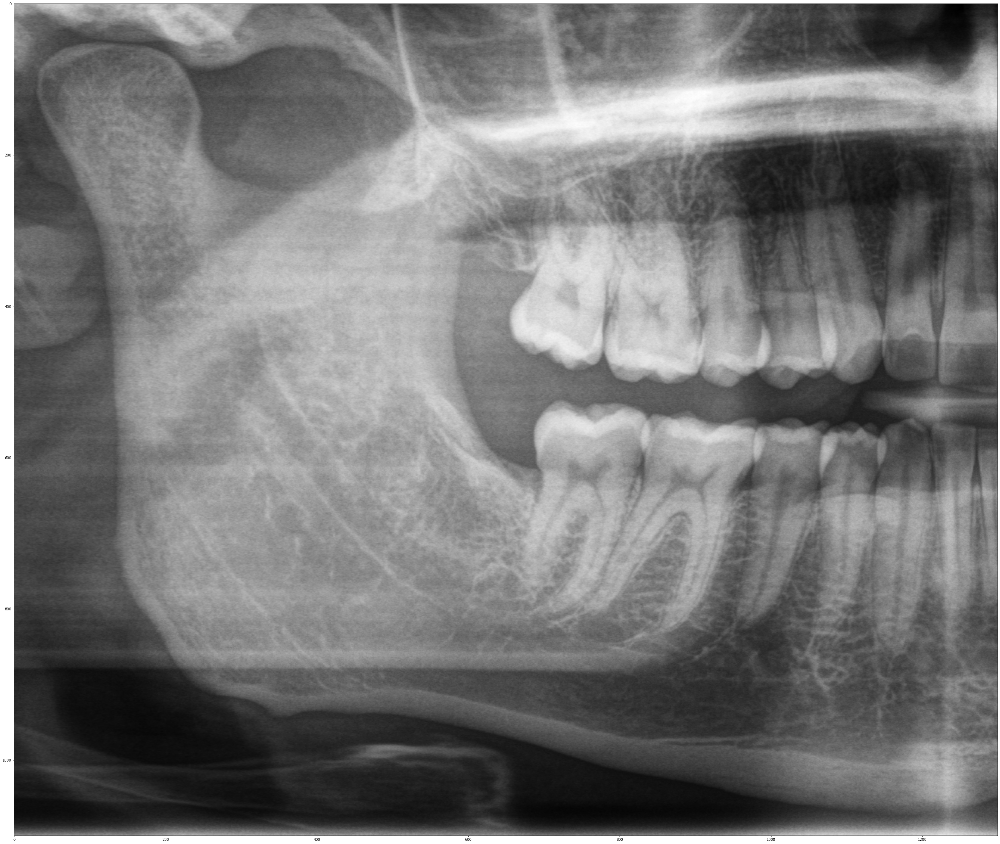

In [3]:
plt.imshow(patch_l_arr)

# U-Net predicted masks after 100 epochs

In [5]:
dir_images = 'data/annotated/patches/images_nmasks'
dir_pred_masks = 'doutputs/cv1/UNET/predicted_masks/'  ## to apply following postprocessing for other experiments, change exp_dir UNET

images = []
masks = []
masks_pred = []
image_ids = []

In [6]:
for file in os.listdir(dir_pred_masks):
    filename = os.fsdecode(file)
    if filename.endswith('.gipl'):
        imagename = filename[:-4] + 'dcm'
        
        #load mask
        path_mask_pred = os.path.join(dir_pred_masks, filename)
        mask_pred = sitk.ReadImage(path_mask_pred)
        masks_pred.append(mask_pred)
        
        path_image = os.path.join(dir_images, imagename)
        path_mask = os.path.join(dir_images, filename)
            
        image = sitk.ReadImage(path_image)
        images.append(image)
            
        mask = sitk.ReadImage(path_mask)
        masks.append(mask)
            
        image_ids.append(filename[:-5])

In [6]:
flatten = lambda l: [item for sublist in l for item in sublist]
#patches_view = [images[0:7], masks[0:7]]
patches_view = [[i,m] for i,m in zip(images[10:15], masks_pred[10:15])]
patches_view = flatten(patches_view)

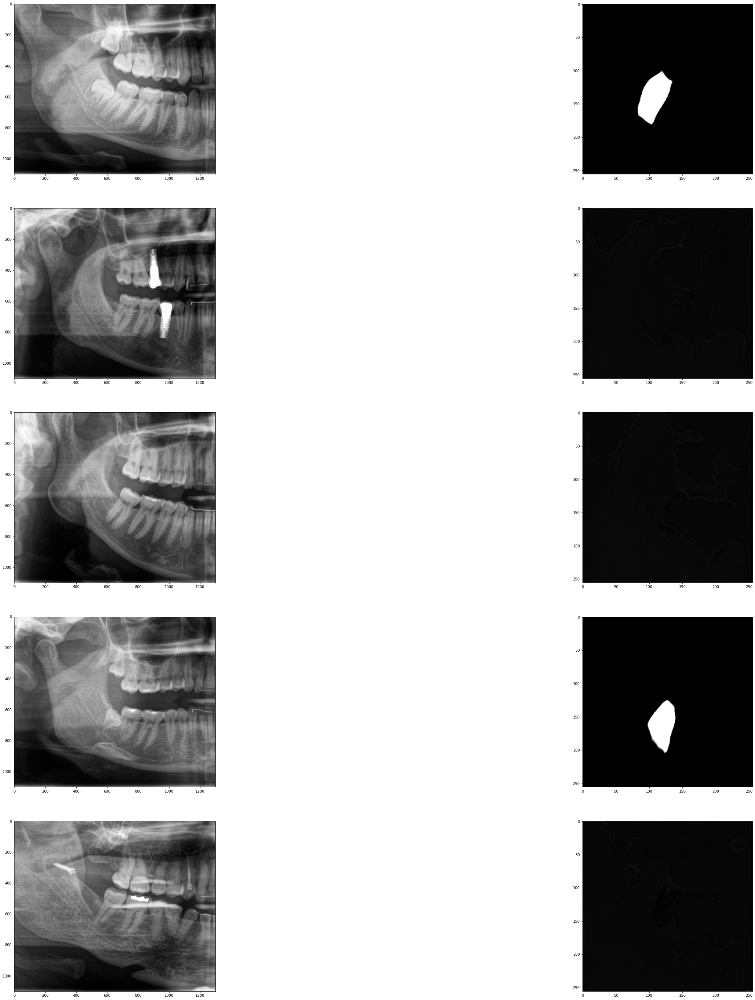

In [7]:
utils.visualize_nimages(patches_view,pairs=True)

In [8]:
path_raw = './data/raw/annotated/originals/19_11.dcm-22.gipl'
raw = sitk.ReadImage(path_raw)
raw_arr = sitk.GetArrayFromImage(raw)[0,:,:]

In [9]:
#import cv2
#cv2.imwrite('../presentations/final/images/sample_mask.png',raw_arr*255)

In [10]:
#plt.imsave('../presentations/final/images/sample_mask.png',raw_arr*255)

In [11]:
print('amount of annotated: ' + str(int(len(os.listdir('./data/raw/annotated/originals'))/2)))
print('amount of not annotated: ' + str(len(os.listdir('./data/raw/not_annotated/originals'))))

amount of annotated: 123
amount of not annotated: 59


In [15]:
image_arrays

[array([[37762, 36373, 35443, ..., 14757, 16038, 15395],
        [35759, 36098, 35347, ..., 14698, 15593, 15794],
        [34602, 33970, 32762, ..., 14265, 15064, 14903],
        ...,
        [40644, 41106, 40839, ..., 55491, 54792, 55613],
        [43853, 44483, 44076, ..., 56082, 55924, 56398],
        [46056, 46123, 45858, ..., 57079, 56839, 57382]], dtype=uint16),
 array([[56031, 55701, 55690, ...,  8451,  8192,  8612],
        [54525, 54284, 54785, ...,  8990,  9266,  8228],
        [54132, 53246, 53650, ...,  7147,  8055,  7517],
        ...,
        [22903, 22457, 22356, ..., 46583, 47614, 48632],
        [24137, 24201, 24429, ..., 48930, 50880, 51840],
        [27073, 27076, 27710, ..., 50765, 51254, 51229]], dtype=uint16),
 array([[62801, 62859, 62960, ..., 29532, 29999, 30062],
        [62814, 62812, 62862, ..., 30033, 31176, 30681],
        [63254, 63155, 63141, ..., 32128, 30622, 29336],
        ...,
        [56304, 56210, 55529, ..., 42779, 42744, 41558],
        [56849, 5

In [14]:
image_arrays[0].max()

58948

# ---------------------------------

In [7]:
# create preprocessed images (so they are compatible with mask dimensions)

image_arrays = [sitk.GetArrayFromImage(image)[0, :, :] for image in images]
masks_arrays = [sitk.GetArrayFromImage(mask)[0, :, :] for mask in masks]
masks_pred_arrays = [sitk.GetArrayFromImage(mask_pred)[0, :, :] for mask_pred in masks_pred]

preprocessed_images = []
for image in image_arrays:
    image = utils.to_tensor(image)
    image = utils.normalize(image)
    image = utils.interpolate_(image, 256)
    image = image.numpy()
    image = image.reshape((256,256))
    preprocessed_images.append(image)

preprocessed_masks_arrays = []
for mask in masks_arrays:
    mask = utils.to_tensor(mask)
    mask = utils.interpolate_(mask, 256)
    mask = mask.numpy()
    mask = mask.reshape((256,256))
    preprocessed_masks_arrays.append(mask)

In [8]:
considered_index = 7
considered_index = 3*considered_index

In [48]:
image_ex1 = preprocessed_images[considered_index]
mask_prep_ex1 = masks_pred_arrays[considered_index]
mask_prep_ex1 = np.around(mask_prep_ex1)
#mask_prep_ex1 = np.where(mask_prep_ex1 > 0.999, 1, 0)  ## with heuristic threshold
mask_ex1 = preprocessed_masks_arrays[considered_index]

image_ex2 = preprocessed_images[considered_index+1]
mask_prep_ex2 = masks_pred_arrays[considered_index+1]
mask_prep_ex2 = np.around(mask_prep_ex2)
#mask_prep_ex2 = np.where(mask_prep_ex2 > 0.999, 1, 0)
mask_ex2 = preprocessed_masks_arrays[considered_index+1]

image_ex3 = preprocessed_images[considered_index+2]
mask_prep_ex3 = masks_pred_arrays[considered_index+2]
mask_prep_ex3 = np.around(mask_prep_ex3)
#mask_prep_ex3 = np.where(mask_prep_ex3 > 0.999, 1, 0)
mask_ex3 = preprocessed_masks_arrays[considered_index+2]

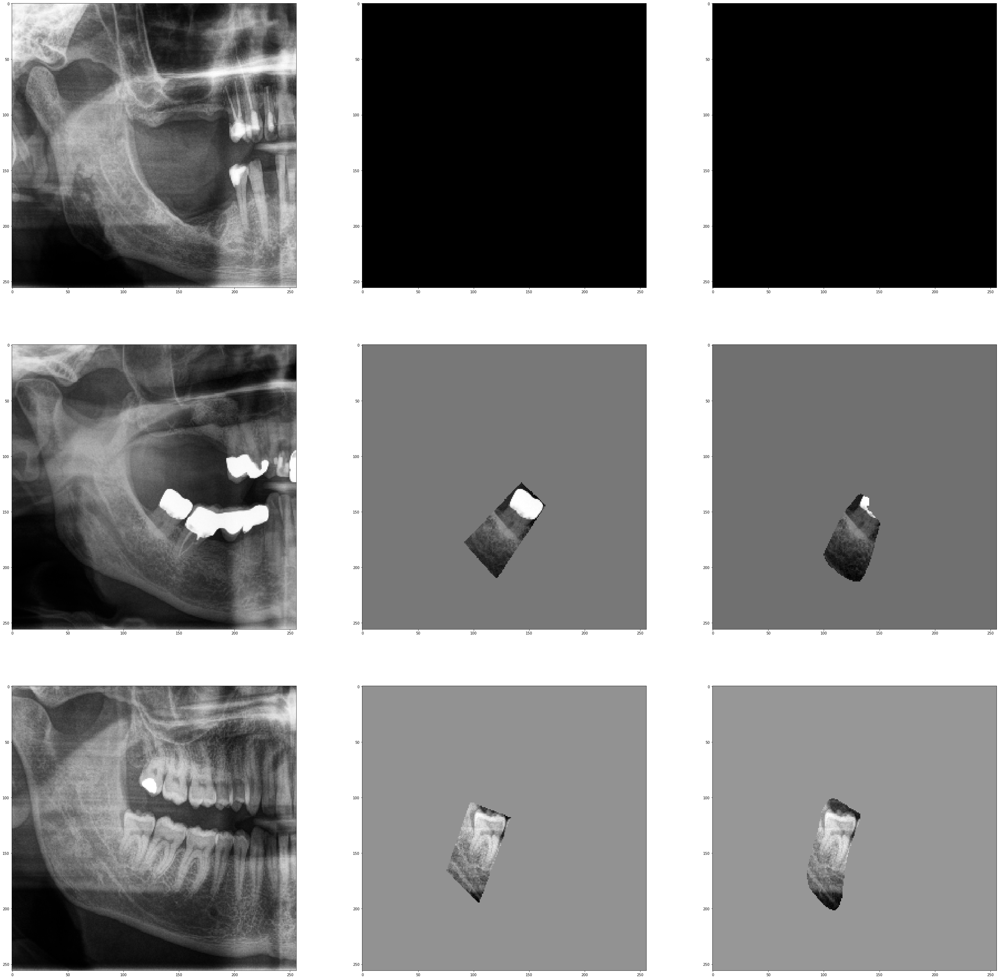

In [49]:
plt.subplot(3, 3, 1)
plt.imshow(image_ex1)
plt.subplot(3, 3, 2)
plt.imshow(image_ex1**mask_ex1)
plt.subplot(3, 3, 3)
plt.imshow(image_ex1**mask_prep_ex1)

plt.subplot(3, 3, 4)
plt.imshow(image_ex2)
plt.subplot(3, 3, 5)
plt.imshow(image_ex2**mask_ex2)
plt.subplot(3, 3, 6)
plt.imshow(image_ex2**mask_prep_ex2)

plt.subplot(3, 3, 7)
plt.imshow(image_ex3)
plt.subplot(3, 3, 8)
plt.imshow(image_ex3**mask_ex3)
plt.subplot(3, 3, 9)
plt.imshow(image_ex3**mask_prep_ex3)

In [141]:
image_ids[31]

'Study-20190311-865--PX-2-065_l'

In [142]:
annotations = pd.read_csv('./data/annotations_new2.csv')

In [149]:
train_df = pd.read_csv('./data/annotated/annotations/all/cv1/train_annotations.csv')
test_df = pd.read_csv('./data/annotated/annotations/all/cv1/test_annotations.csv')

In [150]:
counter = 0
for name in list(train_df['File_name']):
    if name in list(test_df['File_name']):
        counter += 1
print(counter)

0


In [94]:
name_tc = './data/annotated/patches/images_nmasks_original/20_02.dcm-25_r.dcm'
mask_tc = './data/annotated/patches/images_nmasks_original/20_02.dcm-25_r.gipl'

In [95]:
image_test = sitk.ReadImage(name_tc)
image_test = sitk.GetArrayFromImage(image_test)[0,:,:]

mask_test = sitk.ReadImage(mask_tc)
mask_test = sitk.GetArrayFromImage(mask_test)[0,:,:]

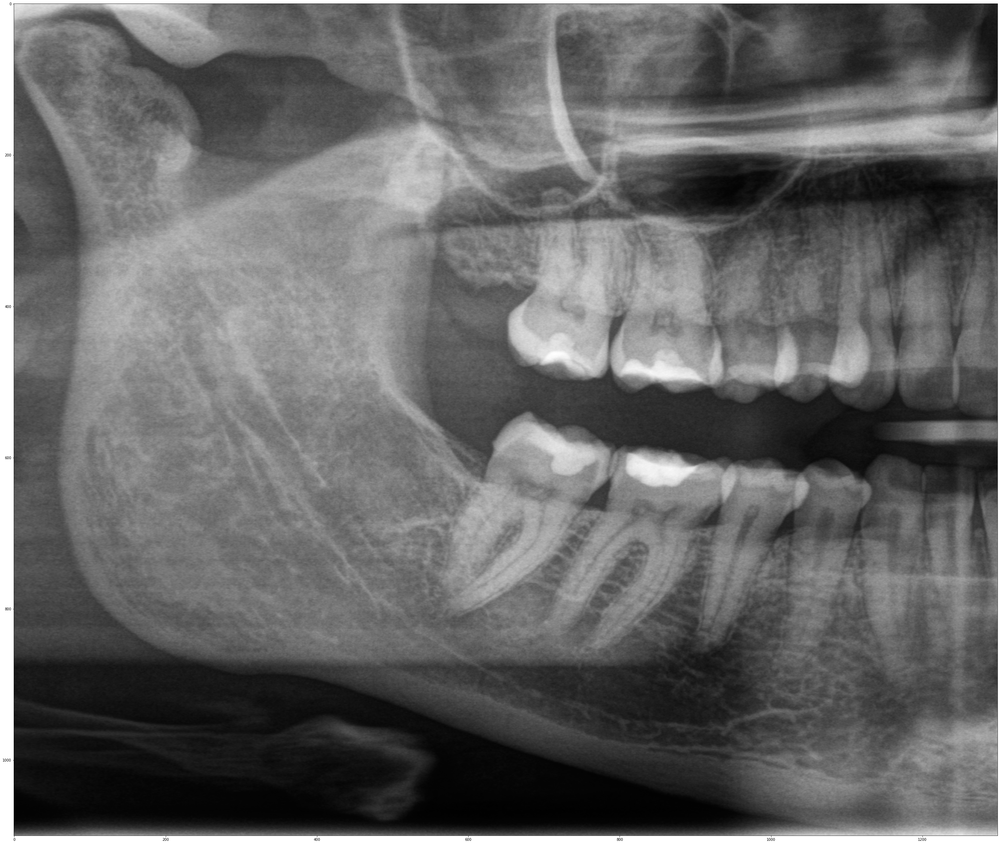

In [96]:
plt.imshow(image_test)

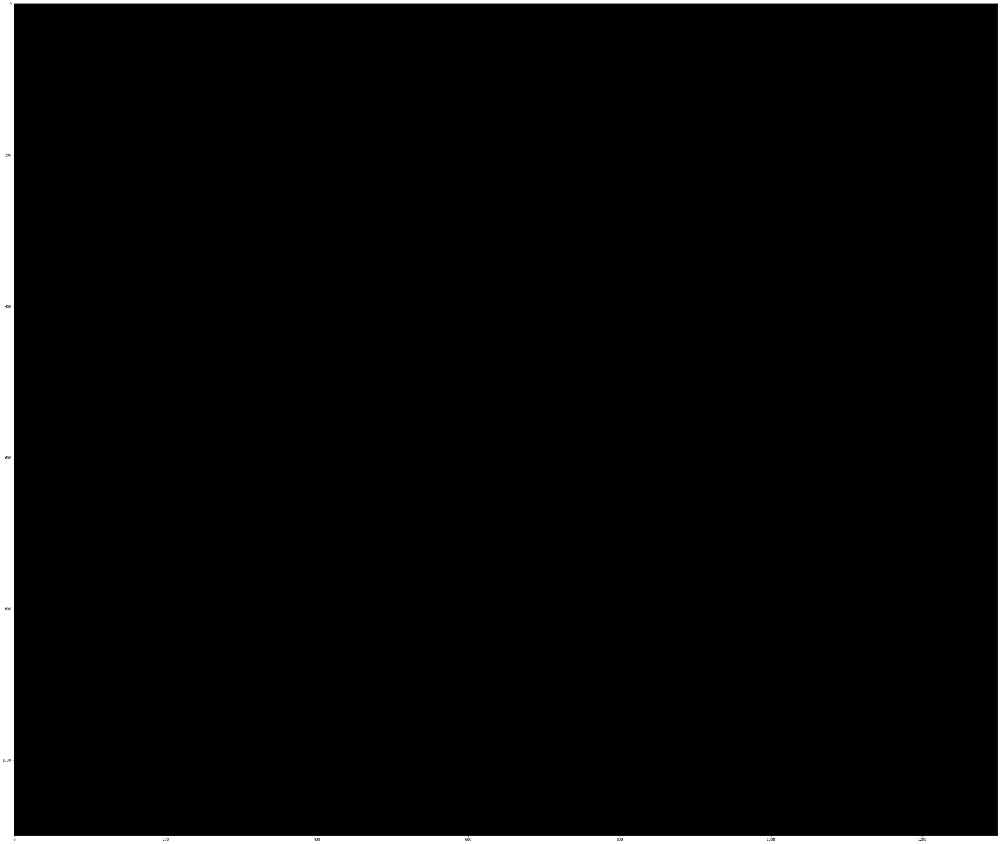

In [97]:
plt.imshow(image_test ** mask_test)

In [70]:
image_ids

['Study-20190813-6113--PX-2-05_l',
 'Study-20190228-1--PX-2-91_l',
 'Study-20190311-8--PX-2-082_l',
 'Study-20181120-4366271427543--PX-2-068_r',
 '20_02.dcm-25_r',
 'Study-20181017-929775--PX-2-042_l',
 'Study-20181029-874099247072--PX-2-023_r',
 '20_01.dcm-35_r',
 'Study-20190919-7834977407220397--PX-2-38_l',
 'Study-20181121-99--PX-2-081_l',
 'Study-20190227-613546243--PX-2-56_l',
 'Study-20190228-13664308--PX-2-14_r',
 'Study-20190711-0137876211258930--PX-2-10_r',
 'Study-20190429-6--PX-2-03_l',
 'Study-20190205-193--PX-2-19_r',
 '19_12.dcm-02_l',
 '20_01.dcm-27_r',
 'Study-20190605-536584547--PX-2-50_l',
 'Study-20190725-8--PX-2-80_l',
 'Study-20181212-85749820--PX-2-13_r',
 'Study-20190412-2888--PX-2-95_r',
 'Study-20181113-7519360821992331--PX-2-019_r',
 'Study-20190521-768678840009617--PX-2-53_r',
 '19_12.dcm-34_l',
 'Study-20190403-472303354--PX-2-74_l',
 '19_11.dcm-24_l',
 'Study-20190718-5755145019245787--PX-2-71_l',
 'Study-20190208-94811371--PX-2-18_l',
 'Study-20190611-624

In [17]:
## possible strat: after treshhold, see if there is still a blob, if no blob ---> no molar
##     if multiple blob ---> choose with the biggest area

In [23]:
presentation_image = image_arrays[5]
c_o_m_presentation_mask = center_of_mass(masks_arrays[5])

In [24]:
c_o_m_presentation_mask

(692.5590784671533, 543.0650742961418)

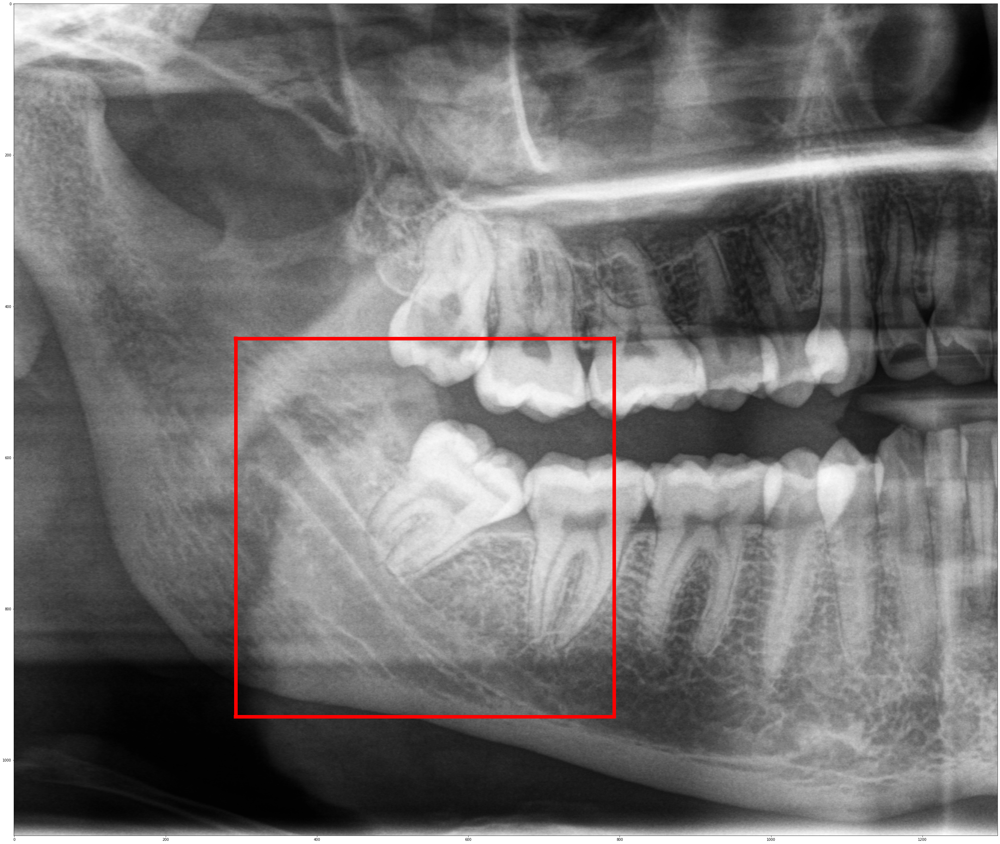

In [25]:
plt.imshow(presentation_image)
#plt.scatter(c_o_m_presentation_mask[1],c_o_m_presentation_mask[0], color='r')
#plt.plot(c_o_m_presentation_mask, 'or')
bottom_lim_x = c_o_m_presentation_mask[1] - 250
top_lim_x = c_o_m_presentation_mask[1] + 250
bottom_lim_y = 1100 - (c_o_m_presentation_mask[0] - 250)
top_lim_y = 1100 - (c_o_m_presentation_mask[0] + 250)

plt.axvline(x=c_o_m_presentation_mask[1]-250 ,ymin=bottom_lim_y/presentation_image.shape[0], ymax=top_lim_y/presentation_image.shape[0] ,color='red', lw=10)
plt.axhline(y=c_o_m_presentation_mask[0]-250 ,xmin=bottom_lim_x/presentation_image.shape[1], xmax=top_lim_x/presentation_image.shape[1] ,color='red', lw=10)
plt.axvline(x=c_o_m_presentation_mask[1]+250 ,ymin=bottom_lim_y/presentation_image.shape[0], ymax=top_lim_y/presentation_image.shape[0] ,color='red', lw=10)
plt.axhline(y=c_o_m_presentation_mask[0]+250 ,xmin=bottom_lim_x/presentation_image.shape[1], xmax=top_lim_x/presentation_image.shape[1] ,color='red', lw=10)

#plt.savefig('../presentations/final/images/sample1_ROI.png')

In [26]:
#plt.imsave('../presentations/final/images/sample1.png',presentation_image)
#plt.imsave('../presentations/final/images/sample1_mask.png',presentation_image*masks_arrays[5])

In [27]:
path_raw = './data/raw/annotated/originals/19_11.dcm-22.dcm'
path_patch_left = './data/annotated/patches/images_nmasks_original/19_11.dcm-22_l.dcm'
path_patch_right = './data/annotated/patches/images_nmasks_original/19_11.dcm-22_r.dcm'

raw = sitk.ReadImage(path_raw)
patch_l = sitk.ReadImage(path_patch_left)
patch_r = sitk.ReadImage(path_patch_right)

raw_arr = sitk.GetArrayFromImage(raw)[0,:,:]
patch_l_arr = sitk.GetArrayFromImage(patch_l)[0,:,:]
patch_r_arr = sitk.GetArrayFromImage(patch_r)[0,:,:]

In [28]:
#plt.imsave('../presentations/final/images/sample2.png',raw_arr)
#plt.imsave('../presentations/final/images/sample2_left.png',patch_l_arr)
#plt.imsave('../presentations/final/images/sample2_right.png',patch_r_arr)

# UNET postprocessing

In [29]:
#mask_to_consider = mask_prep_ex3.astype('uint8')

In [5]:
## apply heuristic ##
threshold = 0.999
postprocessed_masks_pred = []

for mask_pred in masks_pred_arrays:
    mask_after_thres = np.where(mask_pred > 0.999, 1, 0).astype('uint8')
    mask_before_thres = np.around(mask_pred).astype('uint8')
    
    contours_before_th ,hierarchy_before_th = cv2.findContours(mask_before_thres, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
    contours_after_th ,hierarchy_after_th = cv2.findContours(mask_after_thres, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
    
    if len(contours_after_th) == 0:
        postprocessed_masks_pred.append(mask_after_thres)
    elif (len(contours_after_th) == 1) and (len(contours_before_th) == 1):
        postprocessed_masks_pred.append(mask_before_thres)
    else:
        maxContour = 0
        for contour in contours_after_th:
            contourSize = cv2.contourArea(contour)
            if contourSize > maxContour:
                maxContour = contourSize
                maxContourData = contour
        # Create a mask from the largest contour
        output = np.zeros_like(mask_after_thres)
        cv2.fillPoly(output,[maxContourData],1)
        postprocessed_masks_pred.append(output)
    

In [10]:
'''
output = mask_to_consider.copy()

contours,hierarchy = cv2.findContours(mask_to_consider, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)

image_center = np.array([128,128])
maxContour = 0
for contour in contours:
    
    contourSize = cv2.contourArea(contour)
    if contourSize > maxContour:
        maxContour = contourSize
        maxContourData = contour

# Create a mask from the largest contour
output = np.zeros_like(mask_to_consider)
cv2.fillPoly(output,[maxContourData],1)
'''

'\noutput = mask_to_consider.copy()\n\ncontours,hierarchy = cv2.findContours(mask_to_consider, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)\n\nimage_center = np.array([128,128])\nmaxContour = 0\nfor contour in contours:\n    \n    contourSize = cv2.contourArea(contour)\n    if contourSize > maxContour:\n        maxContour = contourSize\n        maxContourData = contour\n\n# Create a mask from the largest contour\noutput = np.zeros_like(mask_to_consider)\ncv2.fillPoly(output,[maxContourData],1)\n'

In [11]:
#plt.subplot(1, 2, 1)
#plt.imshow(mask_to_consider)
#plt.subplot(1, 2, 2)
#plt.imshow(output)

In [12]:
considered_index = 7
considered_index = 3*considered_index

In [13]:
image_ex1 = preprocessed_images[considered_index]
mask_prep_ex1 = postprocessed_masks_pred[considered_index]
mask_ex1 = preprocessed_masks_arrays[considered_index]

image_ex2 = preprocessed_images[considered_index+1]
mask_prep_ex2 = postprocessed_masks_pred[considered_index+1]
mask_ex2 = preprocessed_masks_arrays[considered_index+1]

image_ex3 = preprocessed_images[considered_index+2]
mask_prep_ex3 = postprocessed_masks_pred[considered_index+2]
mask_ex3 = preprocessed_masks_arrays[considered_index+2]

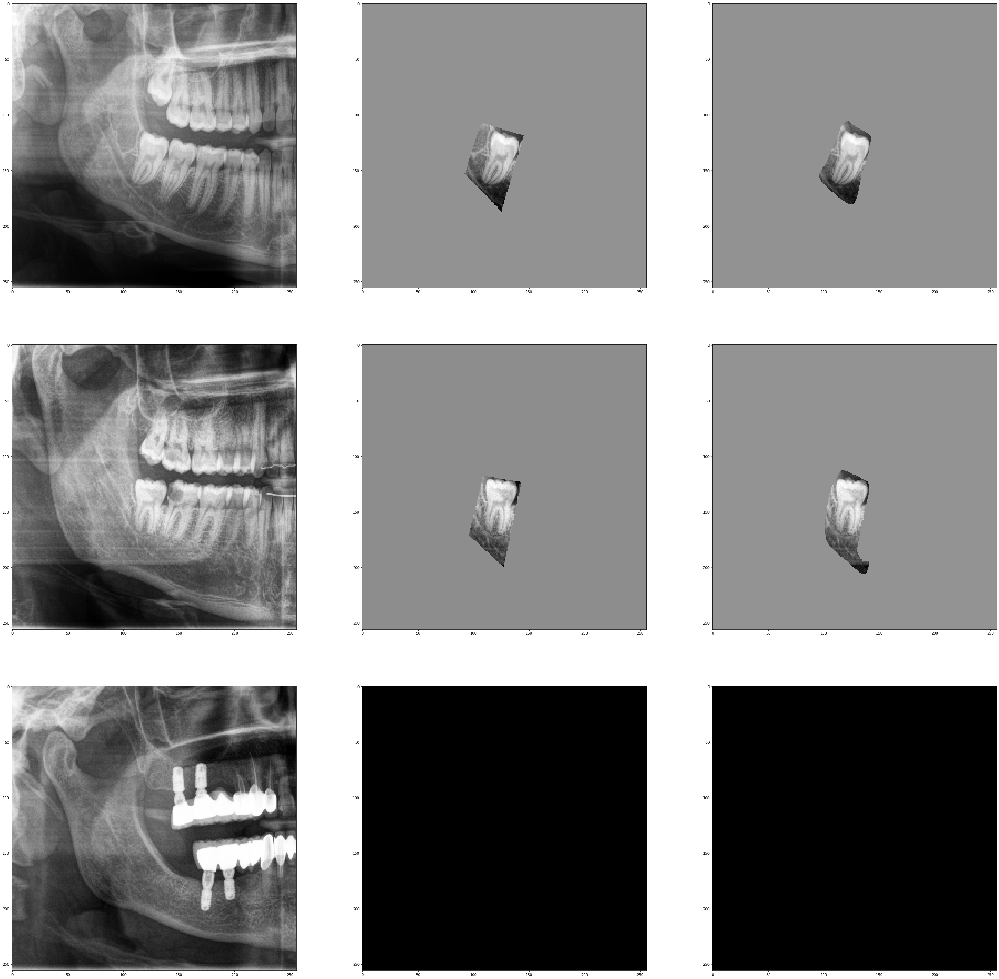

In [14]:
plt.subplot(3, 3, 1)
plt.imshow(image_ex1)
plt.subplot(3, 3, 2)
plt.imshow(image_ex1**mask_ex1)
plt.subplot(3, 3, 3)
plt.imshow(image_ex1**mask_prep_ex1)

plt.subplot(3, 3, 4)
plt.imshow(image_ex2)
plt.subplot(3, 3, 5)
plt.imshow(image_ex2**mask_ex2)
plt.subplot(3, 3, 6)
plt.imshow(image_ex2**mask_prep_ex2)

plt.subplot(3, 3, 7)
plt.imshow(image_ex3)
plt.subplot(3, 3, 8)
plt.imshow(image_ex3**mask_ex3)
plt.subplot(3, 3, 9)
plt.imshow(image_ex3**mask_prep_ex3)

In [36]:
image_arrays[0].shape

(1100, 1300)

In [39]:
#np.all((mask_unet_p == 0))

In [60]:
# go with 5 and 7
for i in [5,7]:
    mask_unet_p = postprocessed_masks_pred[i]
    mask_unet_p = torch.from_numpy(mask_unet_p.astype(float))
    mask_unet_p = interpolate(mask_unet_p.unsqueeze(0).unsqueeze(0), size=(1100, 1300))
    mask_unet_p = mask_unet_p.squeeze(0).squeeze(0).detach().numpy()
    
    mask_unet_raw = masks_pred_arrays[i]
    mask_unet_raw = torch.from_numpy(mask_unet_raw.astype(float))
    mask_unet_raw = interpolate(mask_unet_raw.unsqueeze(0).unsqueeze(0), size=(1100, 1300))
    mask_unet_raw = mask_unet_raw.squeeze(0).squeeze(0).detach().numpy()
    
    image_unet = image_arrays[i]
    plt.imshow(image_unet)
    
    if not np.all((mask_unet_p == 0)):
        c_o_m_mask_unet_p = center_of_mass(mask_unet_p)
        bottom_lim_x = c_o_m_mask_unet_p[1] - 250
        top_lim_x = c_o_m_mask_unet_p[1] + 250
        bottom_lim_y = 1100 - (c_o_m_mask_unet_p[0] - 250)
        top_lim_y = 1100 - (c_o_m_mask_unet_p[0] + 250)

        plt.axvline(x=c_o_m_mask_unet_p[1]-250 ,ymin=bottom_lim_y/image_unet.shape[0], ymax=top_lim_y/image_unet.shape[0] ,color='red', lw=10)
        plt.axhline(y=c_o_m_mask_unet_p[0]-250 ,xmin=bottom_lim_x/image_unet.shape[1], xmax=top_lim_x/image_unet.shape[1] ,color='red', lw=10)
        plt.axvline(x=c_o_m_mask_unet_p[1]+250 ,ymin=bottom_lim_y/image_unet.shape[0], ymax=top_lim_y/image_unet.shape[0] ,color='red', lw=10)
        plt.axhline(y=c_o_m_mask_unet_p[0]+250 ,xmin=bottom_lim_x/image_unet.shape[1], xmax=top_lim_x/image_unet.shape[1] ,color='red', lw=10)

    #plt.savefig(f'../presentations/final/images/unet_final{i}.png')
    #plt.imsave(f'../presentations/final/images/unet_pred_raw{i}.png',mask_unet_raw)
    #plt.imsave(f'../presentations/final/images/unet_pred_pp{i}.png',mask_unet_p)
    
    ## REPORT SAVING
    #plt.savefig(f'../report_images/unet_final{i}.png')
    #mask_unet_raw = (1 - mask_unet_raw) *256
    #plt.imsave(f'../report_images/unet_pred_raw{i}.png',mask_unet_raw)
    #mask_unet_p = (1 - mask_unet_p) *256
    #plt.imsave(f'../report_images/unet_pred_pp{i}.png',mask_unet_p)
    
    plt.clf()

<Figure size 3600x3600 with 0 Axes>

In [56]:
image_rmse = image_arrays[5]
mask_rmse = masks_arrays[5]
com_rmse = center_of_mass(mask_rmse)

In [336]:
image_rmse.shape

(1100, 1300)

In [366]:
[com_rmse[0]]

[692.5590784671533]

In [338]:
ratio_x = 1100/1100
ratio_y = 1300/1300

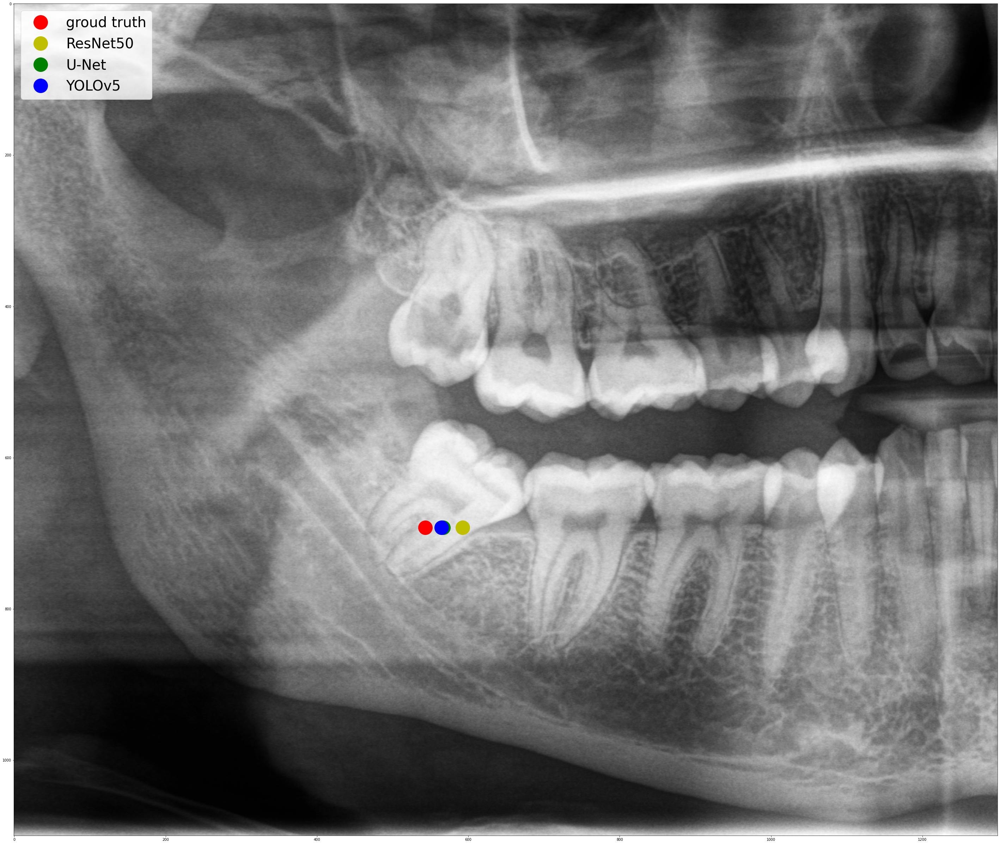

In [339]:
plt.imshow(image_rmse)#[300:900,300:900])
plt.plot(com_rmse[1]*ratio_y, com_rmse[0]*ratio_x, 'or', ms=40, label='groud truth')
plt.plot((com_rmse[1]+49.5)*ratio_y, com_rmse[0]*ratio_x, 'oy', ms=40, label='ResNet50')
plt.plot((com_rmse[1]+23.6)*ratio_y, com_rmse[0]*ratio_x, 'og', ms=40, label='U-Net')
plt.plot((com_rmse[1]+21.7)*ratio_y, com_rmse[0]*ratio_x, 'ob', ms=40, label='YOLOv5')
plt.legend(loc=2, prop={'size': 40})
plt.show()

# YOLO INVESTIGATION

In [100]:
dir_outputs_yolo = './doutputs/cv2/yolo/'

images_yolo = []
image_ids_yolo = []

In [101]:
for id in image_ids:
    for file in os.listdir(dir_outputs_yolo):
        filename = os.fsdecode(file)
        if filename.endswith('.dcm') and (filename[:-4] == id):
                path_image = os.path.join(dir_outputs_yolo, filename)
                image = sitk.ReadImage(path_image)
                images_yolo.append(image)

                # save img id
                image_ids_yolo.append(filename[:-4])

In [17]:
index = 5
index = 6*index

In [18]:
flatten = lambda l: [item for sublist in l for item in sublist]
#patches_view = [images[0:7], masks[0:7]]
patches_view_yolo = [[i,m] for i,m in zip(images_yolo[index:index+3], images_yolo[index+3:index+6])]
patches_view_yolo = flatten(patches_view_yolo)

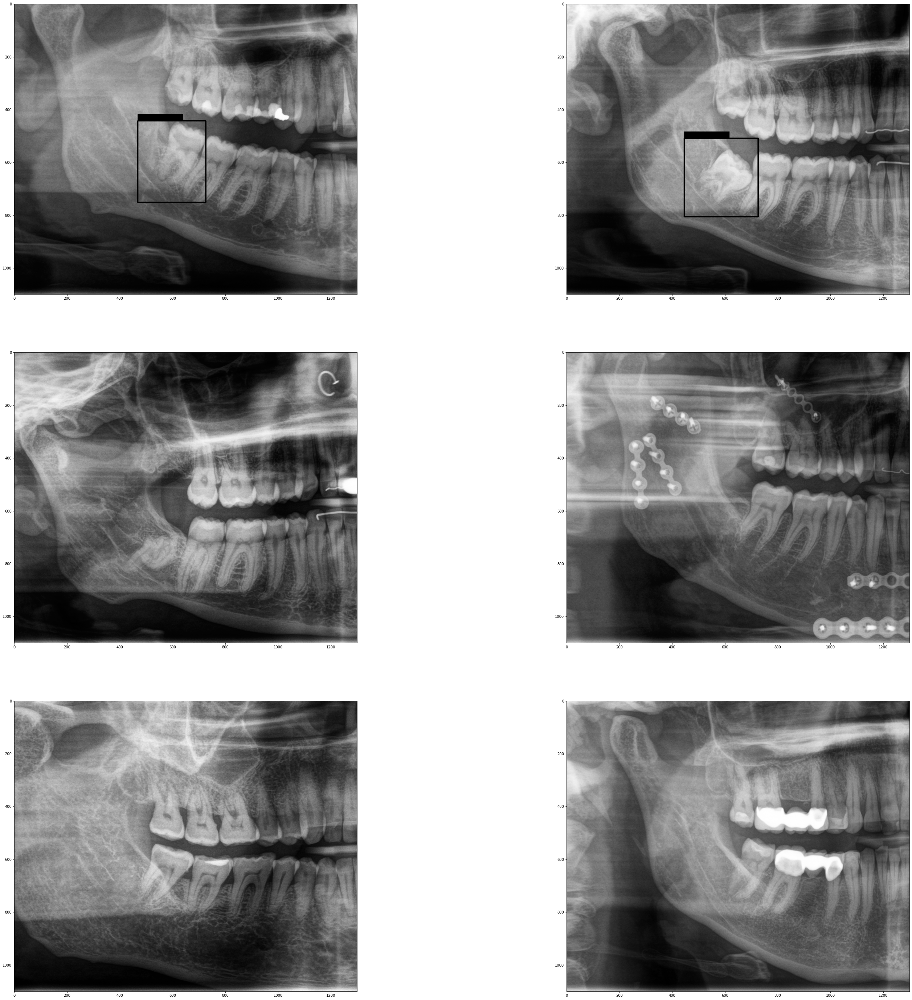

In [19]:
utils.visualize_nimages(patches_view_yolo,pairs=True)

# -------------------------------

# EVALUATION

# -------------------------------

In [346]:
## TRY MEAN EUKLIDIAN DISTANCE

In [347]:
## in format .txt with x and y coordinates, if found a molar, blank otherwise ##

In [19]:
dir_images = 'data/annotated/patches/images_nmasks'
dir_pred_masks = 'doutputs/cv3/yolonew/'  ## to apply following postprocessing for other experiments, change exp_dir UNET

images = []
masks = []
masks_pred = []
image_ids = []

com_yolo_predictions = []

for file in os.listdir(dir_pred_masks):
    filename = os.fsdecode(file)
    if filename.endswith('.dcm'):
        text_name = filename[:-3] + 'txt'
        mask_name = filename[:-3] + 'gipl'
        
        path_image = os.path.join(dir_images, filename)
        path_mask = os.path.join(dir_images, mask_name)
            
        image = sitk.ReadImage(path_image)
        images.append(image)
            
        mask = sitk.ReadImage(path_mask)
        masks.append(mask)
            
        image_ids.append(filename[:-4])
        
        if os.path.isfile(dir_pred_masks+text_name):
            with open(dir_pred_masks+text_name, 'r') as f:
                values = f.readlines()
            values = [x.strip() for x in values]
            if len(values) != 1:      ## in case there are more than one detections ##
                values = [values[0]]
        
            value = values[0].split()[1:3]
            cx = float(value[0])*1300
            cy = float(value[1])*1100
            com_yolo_predictions.append([cx,cy])
        else:
            com_yolo_predictions.append(0)
            
image_arrays = [sitk.GetArrayFromImage(image)[0, :, :] for image in images]
masks_arrays = [sitk.GetArrayFromImage(mask)[0, :, :] for mask in masks]

## 0) gt 

In [20]:
import torch
from torch.nn.functional import interpolate
from scipy.ndimage.measurements import center_of_mass
from sklearn.metrics import mean_squared_error

In [21]:
com_gt = []

for mask in masks_arrays:
    if np.all((mask == 0)):
        com_gt.append(0)
    else:
        cy, cx = center_of_mass(mask)
        com_gt.append([cx, cy])

## 1) UNET

In [104]:
com_UNET_predictions = []

for i,mask in enumerate(postprocessed_masks_pred):
    
    name = image_ids[i]
    mask = torch.from_numpy(mask.astype(float))
    mask = interpolate(mask.unsqueeze(0).unsqueeze(0), size=(1100, 1300))
    mask = mask.squeeze(0).squeeze(0).detach().numpy()
    
    if np.all((mask == 0)):
        com_UNET_predictions.append(0)
    else:
        cy, cx = center_of_mass(mask)
        com_UNET_predictions.append([cx, cy])


In [42]:
## evaluation ##
TN, TP, FN, FP = 0,0,0,0

for i in range(len(com_gt)):
    if (com_gt[i] == 0) and (com_UNET_predictions[i] == 0):
        TN += 1
    elif (com_gt[i] != 0) and (com_UNET_predictions[i] == 0):
        FN += 1
    elif (com_gt[i] == 0) and (com_UNET_predictions[i] != 0):
        FP += 1
    elif (com_gt[i] != 0) and (com_UNET_predictions[i] != 0):
        TP += 1
        
mse_gt = []
mse_unet = []

for i in range(len(com_UNET_predictions)):
    if (com_UNET_predictions[i] !=0) and (com_gt[i] !=0):
        mse_gt.append(com_gt[i])
        mse_unet.append(com_UNET_predictions[i])

med_unet = 0 # mean euklidian distance
for i in range(len(mse_gt)):
    med_unet += np.linalg.norm(np.array(mse_gt[i]) - np.array(mse_unet[i]))

########################
med_unet_reshaped = 0 # mean euklidian distance
ratio_reshaped_y = 800/1100
ratio_reshaped_x = 1600/1300
for i in range(len(mse_gt)):
    med_unet_reshaped += np.linalg.norm(np.array([mse_gt[i][0]*ratio_reshaped_x, mse_gt[i][1]*ratio_reshaped_y]) 
                               - np.array([mse_unet[i][0]*ratio_reshaped_x, mse_unet[i][1]*ratio_reshaped_y]))
########################
    
mae_unet = 0 # mean absolute error
for i in range(len(mse_gt)):
    mae_unet += sum(np.abs(np.array(mse_gt[i]) - np.array(mse_unet[i])))

UNET_recall = TP / (TP+FN)
UNET_precision = TP / (TP+FP)
UNET_F1 = 2. * (UNET_recall * UNET_precision) / (UNET_recall + UNET_precision)
UNET_RMSE = mean_squared_error(mse_unet, mse_gt, squared=False)
UNET_MED = med_unet / len(mse_gt)
UNET_MAE = mae_unet / len(mse_gt)

NameError: name 'com_UNET_predictions' is not defined

In [43]:
med_unet_reshaped/ len(mse_gt)

NameError: name 'med_unet_reshaped' is not defined

In [107]:
print('--- UNET RESULTS ---')
print(f'--> Recall: {UNET_recall}')
print(f'--> Precision: {UNET_precision}')
print(f'--> F1-score: {UNET_F1}')
print(f'--> RMSE: {UNET_RMSE}') ## 48 without outlier
print(f'--> MED: {UNET_MED}') ## 48 without outlier
print(f'--> MAE: {UNET_MAE}') ## 48 without outlier

--- UNET RESULTS ---
--> Recall: 0.959349593495935
--> Precision: 0.921875
--> F1-score: 0.9402390438247011
--> RMSE: 23.324370636160232
--> MED: 25.315594281513484
--> MAE: 32.011753706875254


In [252]:
# CV1:
# --> Recall: 0.9672131147540983
# --> Precision: 0.9554655870445344
# --> F1-score: 0.9613034623217922
# --> RMSE: 17.949545446851793
# --> MED: 21.1467288302545
# --> MAE: 27.031328102844995

In [ ]:
# CV2:
# --> Recall: 0.959349593495935
# --> Precision: 0.921875
# --> F1-score: 0.9402390438247011
# --> RMSE: 23.324370636160232
# --> MED: 25.315594281513484
# --> MAE: 32.011753706875254

In [ ]:
# CV3:
# --> Recall: 0.9545454545454546
# --> Precision: 0.9545454545454546
# --> F1-score: 0.9545454545454546
# --> RMSE: 19.76177943384254
# --> MED: 23.15036837428338
# --> MAE: 29.36621145372694

In [ ]:
# CV4:
# --> Recall: 0.9224489795918367
# --> Precision: 0.9456066945606695
# --> F1-score: 0.9338842975206612
# --> RMSE: 24.767892362191045
# --> MED: 25.983444328310878
# --> MAE: 33.787772475183914

In [ ]:
# CV5:
# --> Recall: 0.9065040650406504
# --> Precision: 0.9369747899159664
# --> F1-score: 0.9214876033057852
# --> RMSE: 18.89778822743168
# --> MED: 21.963250511588512
# --> MAE: 28.181177407295795

In [333]:
print('Recall')
print(np.mean([0.9672131147540983, 0.959349593495935, 0.9545454545454546,
              0.9224489795918367, 0.9065040650406504]))
print(np.std([0.9672131147540983, 0.959349593495935, 0.9545454545454546,
              0.9224489795918367, 0.9065040650406504]))

Recall
0.9420122414855949
0.023393593260542658


In [334]:
print('Precision')
print(np.mean([0.9554655870445344, 0.921875, 0.9545454545454546,
              0.9456066945606695, 0.9369747899159664]))
print(np.std([0.9554655870445344, 0.921875, 0.9545454545454546,
              0.9456066945606695, 0.9369747899159664]))

Precision
0.9428935052133249
0.012473935332664204


In [2]:
print('F1')
print(np.mean([0.9613034623217922, 0.9402390438247011, 0.9545454545454546,
              0.9338842975206612, 0.9214876033057852]))
print(np.std([0.9613034623217922, 0.9402390438247011, 0.9545454545454546,
              0.9338842975206612, 0.9214876033057852]))

F1
0.9422919723036788
0.0142780240912785


In [3]:
print('RMSE')
print(np.mean([17.949545446851793, 23.324370636160232, 19.76177943384254,
              24.767892362191045, 18.89778822743168]))
print(np.std([17.949545446851793, 23.324370636160232, 19.76177943384254,
              24.767892362191045, 18.89778822743168]))

RMSE
20.940275221295458
2.639683085120173


## 2) yolo

In [353]:
## yolo doesn't save a txt file if it doesn't find a molar !!! ##

In [108]:
com_yolo_predictions = []

for id in image_ids:
    if os.path.isfile(dir_outputs_yolo+id+'.txt'):
        with open(dir_outputs_yolo+id+'.txt', 'r') as f:
            values = f.readlines()
        values = [x.strip() for x in values]
        if len(values) != 1:      ## in case there are more than one detections ##
            values = [values[0]]
        
        value = values[0].split()[1:3]
        cx = float(value[0])*1300
        cy = float(value[1])*1100
        com_yolo_predictions.append([cx,cy])
    else:
        com_yolo_predictions.append(0)
        

In [22]:
## evaluation ##
TN, TP, FN, FP = 0,0,0,0

for i in range(len(com_gt)):
    if (com_gt[i] == 0) and (com_yolo_predictions[i] == 0):
        TN += 1
    elif (com_gt[i] != 0) and (com_yolo_predictions[i] == 0):
        FN += 1
    elif (com_gt[i] == 0) and (com_yolo_predictions[i] != 0):
        FP += 1
    elif (com_gt[i] != 0) and (com_yolo_predictions[i] != 0):
        TP += 1
        
mse_gt = []
mse_yolo = []

#for i in range(len(com_UNET_predictions)):
for i in range(len(com_yolo_predictions)):
    if (com_yolo_predictions[i] !=0) and (com_gt[i] !=0):
        mse_gt.append(com_gt[i])
        mse_yolo.append(com_yolo_predictions[i])
        
med_yolo = 0 # mean euklidian distance
for i in range(len(mse_gt)):
    med_yolo += np.linalg.norm(np.array(mse_gt[i]) - np.array(mse_yolo[i]))
    
mae_yolo = 0 # mean absolute error
for i in range(len(mse_gt)):
    mae_yolo += sum(np.abs(np.array(mse_gt[i]) - np.array(mse_yolo[i])))

yolo_recall = TP / (TP+FN)
yolo_precision = TP / (TP+FP)
yolo_F1 = 2. * (yolo_recall * yolo_precision) / (yolo_recall + yolo_precision)
yolo_RMSE = mean_squared_error(mse_yolo, mse_gt, squared=False)
yolo_MED = med_yolo / len(mse_gt)
yolo_MAE = mae_yolo / len(mse_gt)

In [23]:
print('--- YOLO RESULTS ---')
print(f'--> Recall: {yolo_recall}')
print(f'--> Precision: {yolo_precision}')
print(f'--> F1-score: {yolo_F1}')
print(f'--> RMSE: {yolo_RMSE}')
print(f'--> MED: {yolo_MED}')
print(f'--> MAE: {yolo_MAE}')

--- YOLO RESULTS ---
--> Recall: 0.95260663507109
--> Precision: 0.8854625550660793
--> F1-score: 0.9178082191780822
--> RMSE: 21.47186019723084
--> MED: 22.427157280329943
--> MAE: 28.989613648605264


In [ ]:
# CV1:
# --> Recall: 0.8975409836065574
# --> Precision: 0.9521739130434783
# --> F1-score: 0.9240506329113926
# --> RMSE: 20.04896069616523
# --> MED: 21.47314632819327
# --> MAE: 27.269189923688554

In [ ]:
# CV2:
# --> Recall: 0.7357723577235772
# --> Precision: 0.9187817258883249
# --> F1-score: 0.8171557562076749
# --> RMSE: 59.008082190992994
# --> MED: 36.741046732382124
# --> MAE: 47.34087391280785

In [ ]:
# CV3:
# --> Recall: 0.49173553719008267
# --> Precision: 0.9834710743801653
# --> F1-score: 0.6556473829201103
# --> RMSE: 15.739200018437135
# --> MED: 19.038908324331267
# --> MAE: 24.115202060556236

In [ ]:
# CV4:
# --> Recall: 0.8326530612244898
# --> Precision: 0.9902912621359223
# --> F1-score: 0.9046563192904656
# --> RMSE: 23.190137069114854
# --> MED: 23.757631568465175
# --> MAE: 29.61949981272351

In [ ]:
# CV5:
# --> Recall: 0.9428571428571428
# --> Precision: 0.77
# --> F1-score: 0.8477064220183486
# --> RMSE: 58.59124745277204
# --> MED: 37.8914561445681
# --> MAE: 47.781111164688575

In [ ]:
# CV1: (with conf-thres 0.1)
# --> Recall: 0.9221311475409836
# --> Precision: 0.9336099585062241
# --> F1-score: 0.9278350515463919
# --> RMSE: 21.91383782162862
# --> MED: 22.670010772518108
# --> MAE: 28.55804615792307

# CV2: (with conf-thres 0.1)
# --> Recall: 0.8699186991869918
# --> Precision: 0.7925925925925926
# --> F1-score: 0.8294573643410853
# --> RMSE: 88.18236618232002
# --> MED: 59.88638019376092
# --> MAE: 76.57428281643311

# CV3: (with conf-thres 0.1)
# --> Recall: 0.6900826446280992
# --> Precision: 0.9653179190751445
# --> F1-score: 0.8048192771084337
# --> RMSE: 36.78841320086961
# --> MED: 24.672960726139248
# --> MAE: 31.483734431698167

# CV4: (with conf-thres 0.1)
# --> Recall: 0.9102040816326531
# --> Precision: 0.9291666666666667
# --> F1-score: 0.9195876288659794
# --> RMSE: 59.12270664154814
# --> MED: 32.9151394729733
# --> MAE: 42.35855647472453

# CV5: (with conf-thres 0.1)
# --> Recall: 0.9836734693877551
# --> Precision: 0.7392638036809815
# --> F1-score: 0.8441330998248686
# --> RMSE: 76.25167168642012
# --> MED: 51.45129573476533
# --> MAE: 67.57094332625661

In [26]:
# OLD YOLO RESULTS: (for small dataset)
    
# CV1:
# --> Recall: 0.9705882352941176
# --> Precision: 0.9705882352941176
# --> F1-score: 0.9705882352941176
# --> RMSE: 22.89402852028502
# --> MED: 27.94152226408654
# --> MAE: 35.777111569682155
    
# CV2:
# --> Recall: 0.8918918918918919
# --> Precision: 0.9166666666666666
# --> F1-score: 0.9041095890410958
# --> RMSE: 24.07845212324058
# --> MED: 28.680091135872736
# --> MAE: 38.236167877266915
    
# CV3:
# --> Recall: 0.9722222222222222
# --> Precision: 0.9210526315789473
# --> F1-score: 0.9459459459459458
# --> RMSE: 33.18433955184474
# --> MED: 35.661784571990765
# --> MAE: 45.06707432859623

print('Recall')
print(np.mean([0.9705882352941176, 0.8918918918918919, 0.9722222222222222]))
print(np.std([0.9705882352941176, 0.8918918918918919, 0.9722222222222222]))
print('========')
print('Precision')
print(np.mean([0.9705882352941176, 0.9166666666666666, 0.9210526315789473]))
print(np.std([0.9705882352941176, 0.9166666666666666, 0.9210526315789473]))
print('========')
print('F1')
print(np.mean([0.9705882352941176, 0.9041095890410958, 0.9459459459459458]))
print(np.std([0.9705882352941176, 0.9041095890410958, 0.9459459459459458]))
print('========')
print('RMSE')
print(np.mean([22.89402852028502, 24.07845212324058, 33.18433955184474]))
print(np.std([22.89402852028502, 24.07845212324058, 33.18433955184474]))

Recall
0.9449007831360773
0.037488881832028614
Precision
0.9361025111799105
0.024450740245288326
F1
0.9402145900937198
0.027440711018937258
RMSE
26.718940065123444
4.5972279843387875


In [27]:
# NEW YOLO RESULTS:
    
# CV1:
# --> Recall: 0.9241706161137441
# --> Precision: 0.9241706161137441
# --> F1-score: 0.9241706161137441
# --> RMSE: 25.981806971173995
# --> MED: 24.136145163814955
# --> MAE: 31.309993037697485
    
# CV2:
# --> Recall: 0.7644230769230769
# --> Precision: 0.9875776397515528
# --> F1-score: 0.8617886178861788
# --> RMSE: 20.767090255873647
# --> MED: 21.60852522053341
# --> MAE: 27.270466083160454
    
# CV3:
# --> Recall: 0.95260663507109
# --> Precision: 0.8854625550660793
# --> F1-score: 0.9178082191780822
# --> RMSE: 21.47186019723084
# --> MED: 22.427157280329943
# --> MAE: 28.989613648605264

print('Recall')
print(np.mean([0.9241706161137441, 0.7644230769230769, 0.95260663507109]))
print(np.std([0.9241706161137441, 0.7644230769230769, 0.95260663507109]))
print('========')
print('Precision')
print(np.mean([0.9241706161137441, 0.9875776397515528, 0.8854625550660793]))
print(np.std([0.9241706161137441, 0.9875776397515528, 0.8854625550660793]))
print('========')
print('F1')
print(np.mean([0.9241706161137441, 0.8617886178861788, 0.9178082191780822]))
print(np.std([0.9241706161137441, 0.8617886178861788, 0.9178082191780822]))
print('========')
print('RMSE')
print(np.mean([25.981806971173995, 20.767090255873647, 21.47186019723084]))
print(np.std([25.981806971173995, 20.767090255873647, 21.47186019723084]))

Recall
0.8804001093693037
0.08282574412508262
Precision
0.932403603643792
0.04209282751912966
F1
0.9012558177260016
0.028028139682458625
RMSE
22.74025247475949
2.3101128157846835


In [ ]:
# VANILLA MODEL:
    
# CV1:
# --> Recall: 0.819672131147541
# --> Precision: 0.9302325581395349
# --> F1-score: 0.8714596949891069
# --> RMSE: 23.52364985368151
# --> MED: 23.98294518791683
# --> MAE: 30.37440031191409    

In [2]:
print('Recall')
print(np.mean([0.8975409836065574, 0.7357723577235772, 0.49173553719008267,
              0.8326530612244898, 0.9428571428571428]))
print(np.std([0.8975409836065574, 0.7357723577235772, 0.49173553719008267,
              0.8326530612244898, 0.9428571428571428]))
print('\n'+'Recall - thresh 0.1')
print(np.mean([0.9221311475409836, 0.8699186991869918, 0.6900826446280992,
              0.9102040816326531, 0.9836734693877551]))
print(np.std([0.9221311475409836, 0.8699186991869918, 0.6900826446280992,
              0.9102040816326531, 0.9836734693877551]))

Recall
0.78011181652037
0.16010190442892866

Recall - thresh 0.1
0.8752020084752965
0.09948933538773841


In [3]:
print('Precision')
print(np.mean([0.9521739130434783, 0.9187817258883249, 0.9834710743801653,
              0.9902912621359223, 0.77]))
print(np.std([0.9521739130434783, 0.9187817258883249, 0.9834710743801653,
              0.9902912621359223, 0.77]))
print('\n'+'Precision - thresh 0.1')
print(np.mean([0.9336099585062241, 0.7925925925925926, 0.9653179190751445,
              0.9291666666666667, 0.7392638036809815]))
print(np.std([0.9336099585062241, 0.7925925925925926, 0.9653179190751445,
              0.9291666666666667, 0.7392638036809815]))

Precision
0.9229435950895782
0.08057637361871899

Precision - thresh 0.1
0.8719901881043219
0.08910273000135535


In [5]:
print('F1')
print(np.mean([0.9240506329113926, 0.8171557562076749, 0.6556473829201103,
              0.9046563192904656, 0.8477064220183486]))
print(np.std([0.9240506329113926, 0.8171557562076749, 0.6556473829201103,
              0.9046563192904656, 0.8477064220183486]))
print('\n'+'F1 - thresh 0.1')
print(np.mean([0.9278350515463919, 0.8294573643410853, 0.8048192771084337,
              0.9195876288659794, 0.8441330998248686]))
print(np.std([0.9278350515463919, 0.8294573643410853, 0.8048192771084337,
              0.9195876288659794, 0.8441330998248686]))

F1
0.8298433026695984
0.0951801364284186

F1 - thresh 0.1
0.8651664843373519
0.04949412131380345


In [4]:
print('\n'+'RMSE - thresh 0.1')
print(np.mean([21.91383782162862, 88.18236618232002, 36.78841320086961, 59.12270664154814, 76.25167168642012]))
print(np.std([21.91383782162862, 88.18236618232002, 36.78841320086961, 59.12270664154814, 76.25167168642012]))


RMSE - thresh 0.1
56.4517991065573
24.43569971653761


In [48]:
print('F1 - changed thresh')
print(np.mean([0.9240506329113926, 0.8171557562076749, 0.7607052896725441,
              0.9046563192904656, 0.8477064220183486]))
print(np.std([0.9240506329113926, 0.8171557562076749, 0.7607052896725441,
              0.9046563192904656, 0.8477064220183486]))

F1 - changed thresh
0.8508548840200852
0.059202542989692616


## 3) ResNet50

In [17]:
med /3

1.17741585037433

In [357]:
resnet_predictions_df = pd.read_csv('doutputs/cv5/ResNet50/predictions.csv')

In [358]:
mse_resnet = []

for i, id in enumerate(image_ids):
    if id in list(resnet_predictions_df['ids']):
        x = float(resnet_predictions_df[resnet_predictions_df['ids'] == id]['x'])
        y = float(resnet_predictions_df[resnet_predictions_df['ids'] == id]['y'])
        mse_resnet.append([x,y])
mse_gt = [i for i in com_gt if i != 0]
resnet_RMSE = mean_squared_error(mse_resnet, mse_gt, squared=False)

med_resnet = 0 # mean euklidian distance
for i in range(len(mse_gt)):
    med_resnet += np.linalg.norm(np.array(mse_gt[i]) - np.array(mse_resnet[i]))
    
mae_resnet = 0 # mean euklidian distance
for i in range(len(mse_gt)):
    mae_resnet += sum(np.abs(np.array(mse_gt[i]) - np.array(mse_resnet[i])))
    
resnet_MED = med_resnet / len(mse_gt)
resnet_MAE = mae_resnet / len(mse_gt)

In [359]:
print('--- RESNET50 RESULTS ---')
print(f'--> RMSE: {resnet_RMSE}')
print(f'--> MED: {resnet_MED}')
print(f'--> MAE: {resnet_MAE}')

--- RESNET50 RESULTS ---
--> RMSE: 48.976429635408735
--> MED: 60.79662746407025
--> MAE: 80.36743329000997


In [386]:
# MED

#array_med = [28.4, 24.7, 21.0, 25.9, 25.1] #UNET
array_med = [24.1, 23.1, 33.5, 22.7, 24.4] #YOLO
#array_med = [24.1, 23.1, 21.0, 22.7, 24.4]
#array_med = [62.0, 66.3, 57.8, 63.7, 60.8] #RESNET
print(np.mean(array_med))
print(np.std(array_med))

25.560000000000002
4.01875602643405


In [389]:
# MAE

#array_mae = [36.9, 31.7, 26.8, 33.7, 31.9] #UNET
#array_mae = [29.7, 29.1, 42.0, 28.9, 30.9] #YOLO
#array_mae = [77.7, 84.3, 76.4, 81.0, 80.4] #RESNET
print(np.mean(array_mae))
print(np.std(array_mae))

79.96
2.752889391167031


# -------------------------------

# VISUALIZATION

# -------------------------------

## 1) UNET

In [108]:
postprocessed_masks_pred_original_size = []

for mask in postprocessed_masks_pred:
    
    mask = torch.from_numpy(mask.astype(float))
    mask = interpolate(mask.unsqueeze(0).unsqueeze(0), size=(1100, 1300))
    mask = mask.squeeze(0).squeeze(0).detach().numpy()
    
    postprocessed_masks_pred_original_size.append(mask)

In [109]:
considered_index = 5
considered_index = 4*considered_index

image_ex1 = image_arrays[considered_index]
mask_prep_ex1 = postprocessed_masks_pred_original_size[considered_index]
mask_ex1 = masks_arrays[considered_index]
#
com_ex1 = center_of_mass(mask_prep_ex1)
bottom_lim_x1 = com_ex1[1] - 250
top_lim_x1 = com_ex1[1] + 250
bottom_lim_y1 = 1100 - (com_ex1[0] - 250)
top_lim_y1 = 1100 - (com_ex1[0] + 250)

image_ex2 = image_arrays[considered_index+1]
mask_prep_ex2 = postprocessed_masks_pred_original_size[considered_index+1]
mask_ex2 = masks_arrays[considered_index+1]
#
com_ex2 = center_of_mass(mask_prep_ex2)
bottom_lim_x2 = com_ex2[1] - 250
top_lim_x2 = com_ex2[1] + 250
bottom_lim_y2 = 1100 - (com_ex2[0] - 250)
top_lim_y2 = 1100 - (com_ex2[0] + 250)

image_ex3 = image_arrays[considered_index+2]
mask_prep_ex3 = postprocessed_masks_pred_original_size[considered_index+2]
mask_ex3 = masks_arrays[considered_index+2]
#
com_ex3 = center_of_mass(mask_prep_ex3)
bottom_lim_x3 = com_ex3[1] - 250
top_lim_x3 = com_ex3[1] + 250
bottom_lim_y3 = 1100 - (com_ex3[0] - 250)
top_lim_y3 = 1100 - (com_ex3[0] + 250)

image_ex4 = image_arrays[considered_index+3]
mask_prep_ex4 = postprocessed_masks_pred_original_size[considered_index+3]
mask_ex4 = masks_arrays[considered_index+3]
#
com_ex4 = center_of_mass(mask_prep_ex4)
bottom_lim_x4 = com_ex4[1] - 250
top_lim_x4 = com_ex4[1] + 250
bottom_lim_y4 = 1100 - (com_ex4[0] - 250)
top_lim_y4 = 1100 - (com_ex4[0] + 250)

/opt/anaconda3/envs/project_dental_surgery/lib/python3.8/site-packages/scipy/ndimage/measurements.py:1385: RuntimeWarning: invalid value encountered in double_scalars
  results = [sum(input * grids[dir].astype(float), labels, index) / normalizer


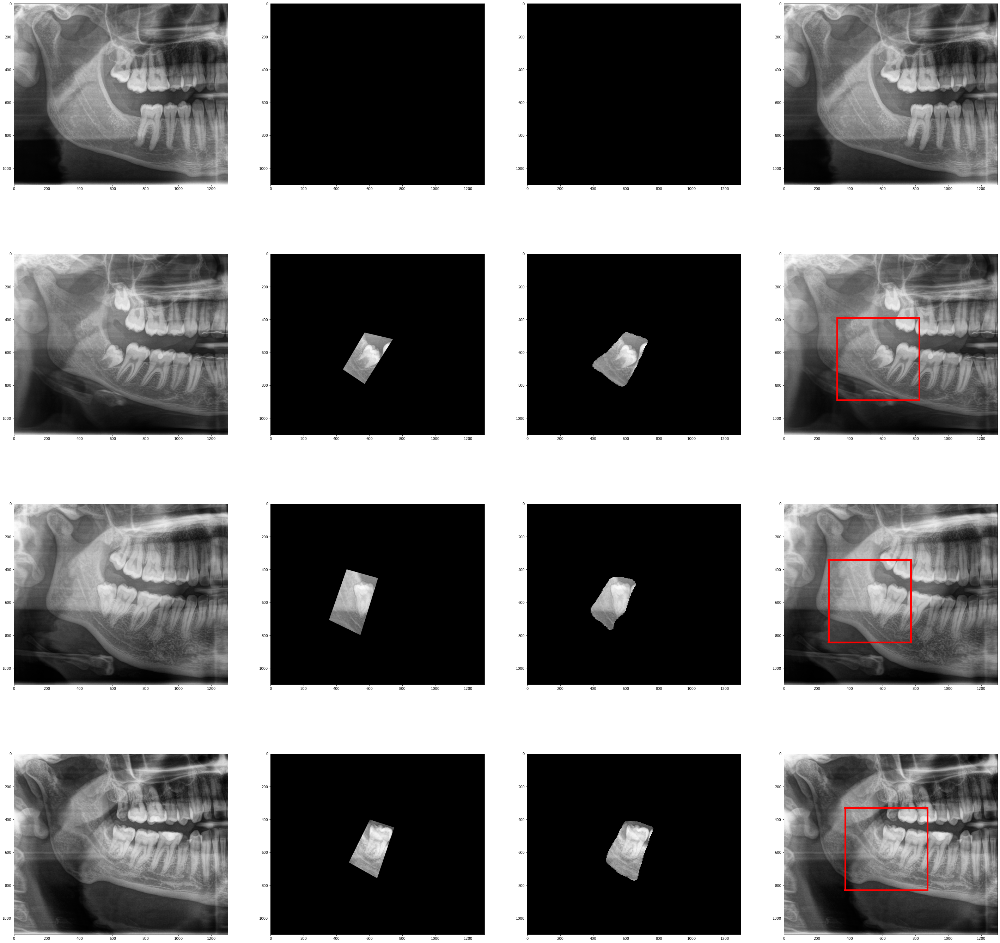

In [112]:
fig = plt.figure()

ax1 = fig.add_subplot(4, 4, 1)
ax1.imshow(image_ex1)
ax2 = fig.add_subplot(4, 4, 2)
ax2.imshow(image_ex1**mask_ex1)
ax3 = fig.add_subplot(4, 4, 3)
ax3.imshow(image_ex1**mask_prep_ex1)
ax4 = fig.add_subplot(4, 4, 4)
ax4.imshow(image_ex1)
ax4.axvline(x=com_ex1[1]-250 ,ymin=bottom_lim_y1/image_ex1.shape[0], ymax=top_lim_y1/image_ex1.shape[0] ,color='red', lw=5)
ax4.axhline(y=com_ex1[0]-250 ,xmin=bottom_lim_x1/image_ex1.shape[1], xmax=top_lim_x1/image_ex1.shape[1] ,color='red', lw=5)
ax4.axvline(x=com_ex1[1]+250 ,ymin=bottom_lim_y1/image_ex1.shape[0], ymax=top_lim_y1/image_ex1.shape[0] ,color='red', lw=5)
ax4.axhline(y=com_ex1[0]+250 ,xmin=bottom_lim_x1/image_ex1.shape[1], xmax=top_lim_x1/image_ex1.shape[1] ,color='red', lw=5)

ax5 = fig.add_subplot(4, 4, 5)
ax5.imshow(image_ex2)
ax6 = fig.add_subplot(4, 4, 6)
ax6.imshow(image_ex2**mask_ex2)
ax7 = fig.add_subplot(4, 4, 7)
ax7.imshow(image_ex2**mask_prep_ex2)
ax8 = fig.add_subplot(4, 4, 8)
ax8.imshow(image_ex2)
ax8.axvline(x=com_ex2[1]-250 ,ymin=bottom_lim_y2/image_ex2.shape[0], ymax=top_lim_y2/image_ex2.shape[0] ,color='red', lw=5)
ax8.axhline(y=com_ex2[0]-250 ,xmin=bottom_lim_x2/image_ex2.shape[1], xmax=top_lim_x2/image_ex2.shape[1] ,color='red', lw=5)
ax8.axvline(x=com_ex2[1]+250 ,ymin=bottom_lim_y2/image_ex2.shape[0], ymax=top_lim_y2/image_ex2.shape[0] ,color='red', lw=5)
ax8.axhline(y=com_ex2[0]+250 ,xmin=bottom_lim_x2/image_ex2.shape[1], xmax=top_lim_x2/image_ex2.shape[1] ,color='red', lw=5)

ax9 = fig.add_subplot(4, 4, 9)
ax9.imshow(image_ex3)
ax10 = fig.add_subplot(4, 4, 10)
ax10.imshow(image_ex3**mask_ex3)
ax11 = fig.add_subplot(4, 4, 11)
ax11.imshow(image_ex3**mask_prep_ex3)
ax12 = fig.add_subplot(4, 4, 12)
ax12.imshow(image_ex3)
ax12.axvline(x=com_ex3[1]-250 ,ymin=bottom_lim_y3/image_ex3.shape[0], ymax=top_lim_y3/image_ex3.shape[0] ,color='red', lw=5)
ax12.axhline(y=com_ex3[0]-250 ,xmin=bottom_lim_x3/image_ex3.shape[1], xmax=top_lim_x3/image_ex3.shape[1] ,color='red', lw=5)
ax12.axvline(x=com_ex3[1]+250 ,ymin=bottom_lim_y3/image_ex3.shape[0], ymax=top_lim_y3/image_ex3.shape[0] ,color='red', lw=5)
ax12.axhline(y=com_ex3[0]+250 ,xmin=bottom_lim_x3/image_ex3.shape[1], xmax=top_lim_x3/image_ex3.shape[1] ,color='red', lw=5)

ax13 = fig.add_subplot(4, 4, 13)
ax13.imshow(image_ex4)
ax14 = fig.add_subplot(4, 4, 14)
ax14.imshow(image_ex4**mask_ex4)
ax15 = fig.add_subplot(4, 4, 15)
ax15.imshow(image_ex4**mask_prep_ex4)
ax16 = fig.add_subplot(4, 4, 16)
ax16.imshow(image_ex4)
#ax16.axvline(x=com_ex4[1]-250 ,ymin=bottom_lim_y4/image_ex4.shape[0], ymax=top_lim_y4/image_ex4.shape[0] ,color='red', lw=5)
#ax16.axhline(y=com_ex4[0]-250 ,xmin=bottom_lim_x4/image_ex4.shape[1], xmax=top_lim_x4/image_ex4.shape[1] ,color='red', lw=5)
#ax16.axvline(x=com_ex4[1]+250 ,ymin=bottom_lim_y4/image_ex4.shape[0], ymax=top_lim_y4/image_ex4.shape[0] ,color='red', lw=5)
#ax16.axhline(y=com_ex4[0]+250 ,xmin=bottom_lim_x4/image_ex4.shape[1], xmax=top_lim_x4/image_ex4.shape[1] ,color='red', lw=5)
ax16.axvline(x=com_ex4[1]-250 ,ymin=bottom_lim_y4/image_ex4.shape[0], ymax=top_lim_y4/image_ex4.shape[0] ,color='red', lw=5)
ax16.axhline(y=com_ex4[0]-250 ,xmin=bottom_lim_x4/image_ex4.shape[1], xmax=top_lim_x4/image_ex4.shape[1] ,color='red', lw=5)
ax16.axvline(x=com_ex4[1]+250 ,ymin=bottom_lim_y4/image_ex4.shape[0], ymax=top_lim_y4/image_ex4.shape[0] ,color='red', lw=5)
ax16.axhline(y=com_ex4[0]+250 ,xmin=bottom_lim_x4/image_ex4.shape[1], xmax=top_lim_x4/image_ex4.shape[1] ,color='red', lw=5)

In [643]:
#fig.savefig('../presentations/final/images/UNET5.png')

## 2) YOLO

In [ ]:
# BE VERY CAREFUL WITH CENTROID INDEXES

In [671]:
images_arrays_yolo = [sitk.GetArrayFromImage(image)[0, :, :] for image in images_yolo]

In [672]:
'''
considered_index = 1
considered_index = 4*considered_index

image_ex1 = image_arrays[considered_index]
mask_prep_ex1 = images_arrays_yolo[considered_index]
mask_ex1 = masks_arrays[considered_index]

image_ex2 = image_arrays[considered_index+1]
mask_prep_ex2 = images_arrays_yolo[considered_index+1]
mask_ex2 = masks_arrays[considered_index+1]

image_ex3 = image_arrays[considered_index+2]
mask_prep_ex3 = images_arrays_yolo[considered_index+2]
mask_ex3 = masks_arrays[considered_index+2]

image_ex4 = image_arrays[considered_index+3]
mask_prep_ex4 = images_arrays_yolo[considered_index+3]
mask_ex4 = masks_arrays[considered_index+3]
'''

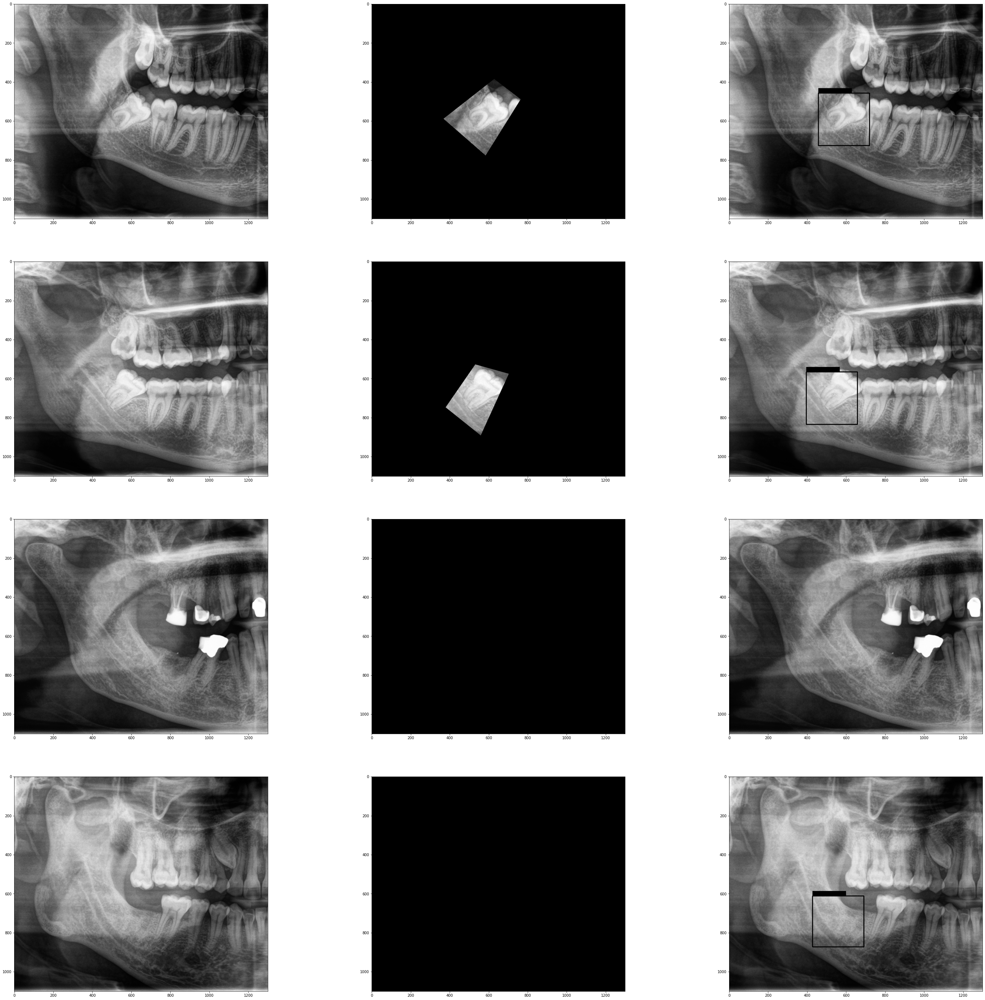

In [673]:
'''
fig = plt.figure()

ax1 = fig.add_subplot(4, 3, 1)
ax1.imshow(image_ex1)
ax2 = fig.add_subplot(4, 3, 2)
ax2.imshow(image_ex1**mask_ex1)
ax3 = fig.add_subplot(4, 3, 3)
ax3.imshow(mask_prep_ex1)

ax4 = fig.add_subplot(4, 3, 4)
ax4.imshow(image_ex2)
ax5 = fig.add_subplot(4, 3, 5)
ax5.imshow(image_ex2**mask_ex2)
ax6 = fig.add_subplot(4, 3, 6)
ax6.imshow(mask_prep_ex2)

ax7 = fig.add_subplot(4, 3, 7)
ax7.imshow(image_ex3)
ax8 = fig.add_subplot(4, 3, 8)
ax8.imshow(image_ex3**mask_ex3)
ax9 = fig.add_subplot(4, 3, 9)
ax9.imshow(mask_prep_ex3)

ax7 = fig.add_subplot(4, 3, 10)
ax7.imshow(image_ex4)
ax8 = fig.add_subplot(4, 3, 11)
ax8.imshow(image_ex4**mask_ex4)
ax9 = fig.add_subplot(4, 3, 12)
ax9.imshow(mask_prep_ex4)
'''

In [691]:
image_ooo = image_arrays[5]
mask_prep_ooo = images_arrays_yolo[5]
com_ooo = com_yolo_predictions[5]

In [692]:
com_ooo

[525.9995, 699.4998999999999]

In [699]:
bottom_lim_x1_ooo = com_ooo[0] - 250
top_lim_x1_ooo = com_ooo[0] + 250
bottom_lim_y1_ooo = 1100 - (com_ooo[1] - 250)
top_lim_y1_ooo = 1100 - (com_ooo[1] + 250)

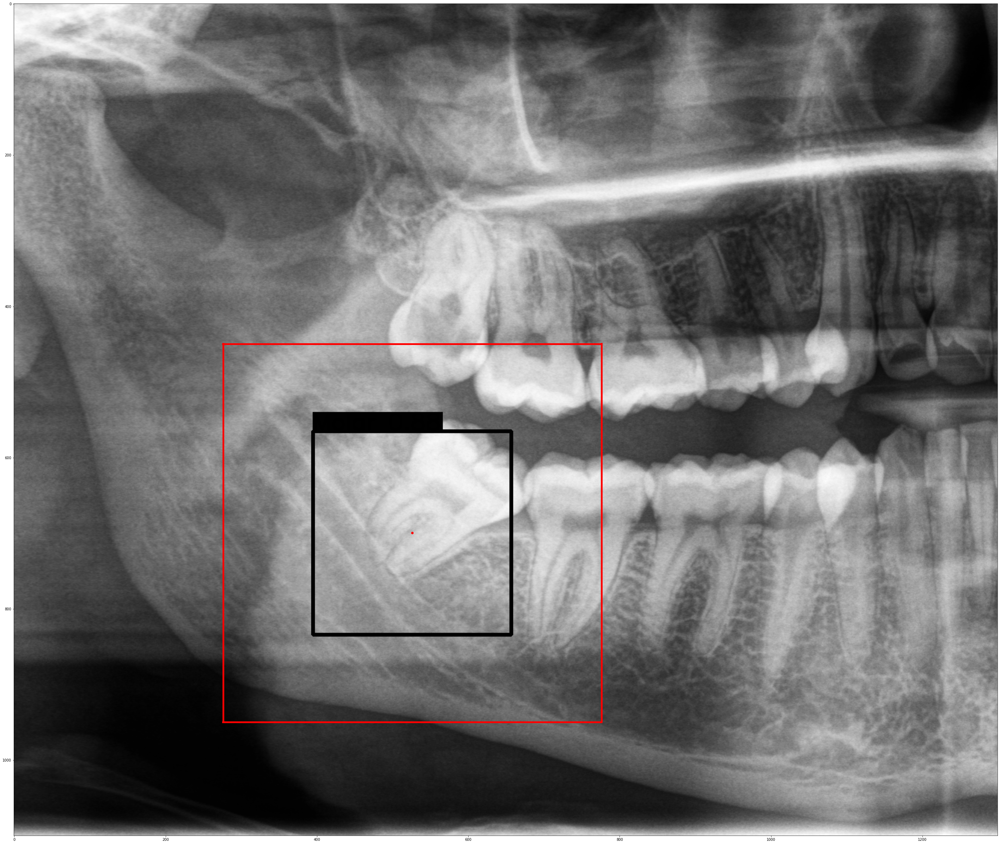

In [700]:
plt.imshow(mask_prep_ooo)
plt.plot(com_ooo[0], com_ooo[1], 'or')
plt.axvline(x=com_ooo[0]-250 ,ymin=bottom_lim_y1_ooo/image_ooo.shape[0], ymax=top_lim_y1_ooo/image_ooo.shape[0] ,color='red', lw=5)
plt.axhline(y=com_ooo[1]-250 ,xmin=bottom_lim_x1_ooo/image_ooo.shape[1], xmax=top_lim_x1_ooo/image_ooo.shape[1] ,color='red', lw=5)
plt.axvline(x=com_ooo[0]+250 ,ymin=bottom_lim_y1_ooo/image_ooo.shape[0], ymax=top_lim_y1_ooo/image_ooo.shape[0] ,color='red', lw=5)
plt.axhline(y=com_ooo[1]+250 ,xmin=bottom_lim_x1_ooo/image_ooo.shape[1], xmax=top_lim_x1_ooo/image_ooo.shape[1] ,color='red', lw=5)

In [710]:
considered_index = 5
considered_index = 4*considered_index

image_ex1 = image_arrays[considered_index]
#
com_ex1 = com_yolo_predictions[considered_index]
if type(com_ex1) == int:  ## CAREFUL: INDEXES FOR YOLO COM AND GT COM ARE SWITCHED!!!
    bottom_lim_x1 = None
    top_lim_x1 = None
    bottom_lim_y1 = None
    top_lim_y1 = None
else:
    bottom_lim_x1 = com_ex1[0] - 250
    top_lim_x1 = com_ex1[0] + 250
    bottom_lim_y1 = 1100 - (com_ex1[1] - 250)
    top_lim_y1 = 1100 - (com_ex1[1] + 250)
mask_ex1_gt = masks_arrays[considered_index]
#
com_ex1_gt = center_of_mass(mask_ex1_gt)
bottom_lim_x1_gt = com_ex1_gt[1] - 250
top_lim_x1_gt = com_ex1_gt[1] + 250
bottom_lim_y1_gt = 1100 - (com_ex1_gt[0] - 250)
top_lim_y1_gt = 1100 - (com_ex1_gt[0] + 250)


image_ex2 = image_arrays[considered_index+1]
com_ex2 = com_yolo_predictions[considered_index+1]
if type(com_ex2) == int:
    bottom_lim_x2 = None
    top_lim_x2 = None
    bottom_lim_y2 = None
    top_lim_y2 = None
else:
    bottom_lim_x2 = com_ex2[0] - 250
    top_lim_x2 = com_ex2[0] + 250
    bottom_lim_y2 = 1100 - (com_ex2[1] - 250)
    top_lim_y2 = 1100 - (com_ex2[1] + 250)
mask_ex2_gt = masks_arrays[considered_index+1]
#
com_ex2_gt = center_of_mass(mask_ex2_gt)
bottom_lim_x2_gt = com_ex2_gt[1] - 250
top_lim_x2_gt = com_ex2_gt[1] + 250
bottom_lim_y2_gt = 1100 - (com_ex2_gt[0] - 250)
top_lim_y2_gt = 1100 - (com_ex2_gt[0] + 250)


image_ex3 = image_arrays[considered_index+2]
com_ex3 = com_yolo_predictions[considered_index+2]
if type(com_ex3) == int:
    bottom_lim_x3 = None
    top_lim_x3 = None
    bottom_lim_y3 = None
    top_lim_y3 = None
else:
    bottom_lim_x3 = com_ex3[0] - 250
    top_lim_x3 = com_ex3[0] + 250
    bottom_lim_y3 = 1100 - (com_ex3[1] - 250)
    top_lim_y3 = 1100 - (com_ex3[1] + 250)
mask_ex3_gt = masks_arrays[considered_index+2]
#
com_ex3_gt = center_of_mass(mask_ex3_gt)
bottom_lim_x3_gt = com_ex3_gt[1] - 250
top_lim_x3_gt = com_ex3_gt[1] + 250
bottom_lim_y3_gt = 1100 - (com_ex3_gt[0] - 250)
top_lim_y3_gt = 1100 - (com_ex3_gt[0] + 250)


image_ex4 = image_arrays[considered_index+3]
com_ex4 = com_yolo_predictions[considered_index+3]
if type(com_ex4) == int:
    bottom_lim_x4 = None
    top_lim_x4 = None
    bottom_lim_y4 = None
    top_lim_y4 = None
else:
    bottom_lim_x4 = com_ex4[0] - 250
    top_lim_x4 = com_ex4[0] + 250
    bottom_lim_y4 = 1100 - (com_ex4[1] - 250)
    top_lim_y4 = 1100 - (com_ex4[1] + 250)
mask_ex4_gt = masks_arrays[considered_index+3]
#
com_ex4_gt = center_of_mass(mask_ex4_gt)
bottom_lim_x4_gt = com_ex4_gt[1] - 250
top_lim_x4_gt = com_ex4_gt[1] + 250
bottom_lim_y4_gt = 1100 - (com_ex4_gt[0] - 250)
top_lim_y4_gt = 1100 - (com_ex4_gt[0] + 250)

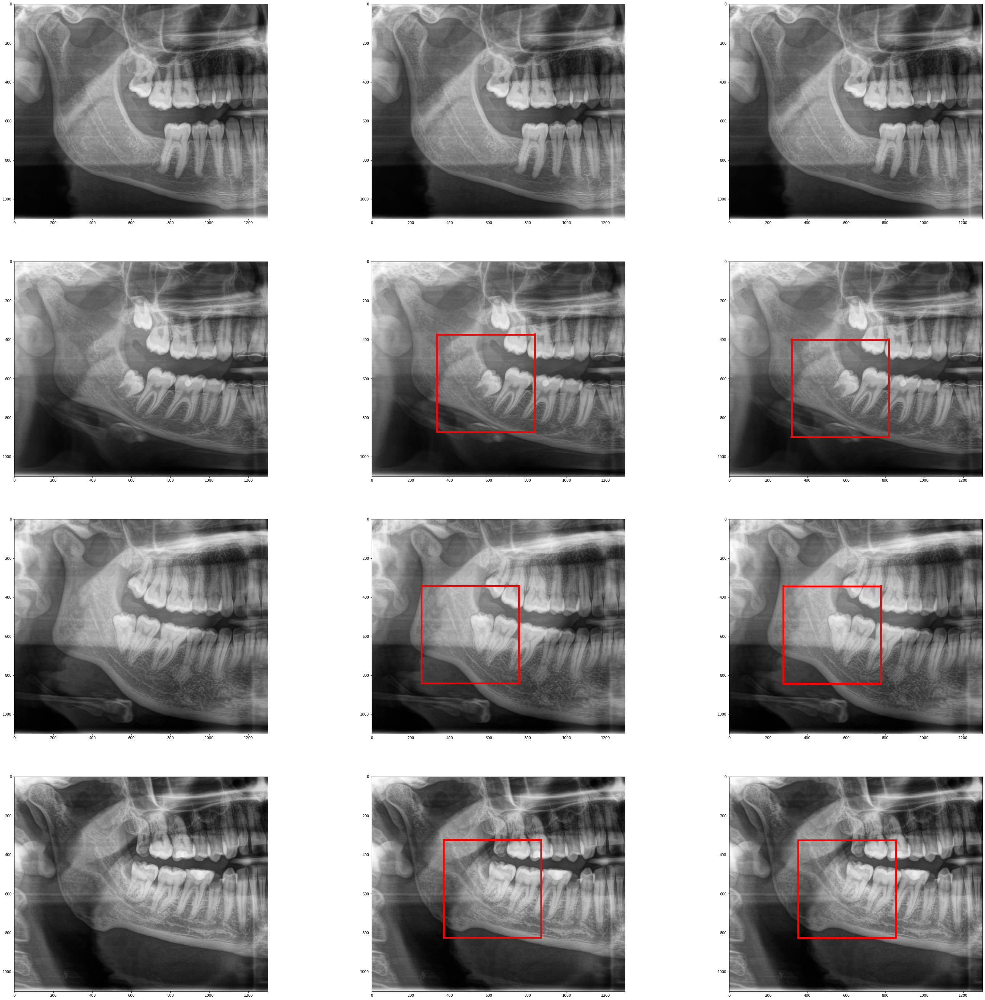

In [711]:
fig = plt.figure()

ax1 = fig.add_subplot(4, 3, 1)
ax1.imshow(image_ex1)
ax2 = fig.add_subplot(4, 3, 2)
ax2.imshow(image_ex1)
ax2.axvline(x=com_ex1_gt[1]-250 ,ymin=bottom_lim_y1_gt/image_ex1.shape[0], ymax=top_lim_y1_gt/image_ex1.shape[0] ,color='red', lw=5)
ax2.axhline(y=com_ex1_gt[0]-250 ,xmin=bottom_lim_x1_gt/image_ex1.shape[1], xmax=top_lim_x1_gt/image_ex1.shape[1] ,color='red', lw=5)
ax2.axvline(x=com_ex1_gt[1]+250 ,ymin=bottom_lim_y1_gt/image_ex1.shape[0], ymax=top_lim_y1_gt/image_ex1.shape[0] ,color='red', lw=5)
ax2.axhline(y=com_ex1_gt[0]+250 ,xmin=bottom_lim_x1_gt/image_ex1.shape[1], xmax=top_lim_x1_gt/image_ex1.shape[1] ,color='red', lw=5)
ax3 = fig.add_subplot(4, 3, 3)
ax3.imshow(image_ex1)
if bottom_lim_y1 != None:
    ax3.axvline(x=com_ex1[0]-250 ,ymin=bottom_lim_y1/image_ex1.shape[0], ymax=top_lim_y1/image_ex1.shape[0] ,color='red', lw=5)
    ax3.axhline(y=com_ex1[1]-250 ,xmin=bottom_lim_x1/image_ex1.shape[1], xmax=top_lim_x1/image_ex1.shape[1] ,color='red', lw=5)
    ax3.axvline(x=com_ex1[0]+250 ,ymin=bottom_lim_y1/image_ex1.shape[0], ymax=top_lim_y1/image_ex1.shape[0] ,color='red', lw=5)
    ax3.axhline(y=com_ex1[1]+250 ,xmin=bottom_lim_x1/image_ex1.shape[1], xmax=top_lim_x1/image_ex1.shape[1] ,color='red', lw=5)

    
ax4 = fig.add_subplot(4, 3, 4)
ax4.imshow(image_ex2)
ax5 = fig.add_subplot(4, 3, 5)
ax5.imshow(image_ex2)
ax5.axvline(x=com_ex2_gt[1]-250 ,ymin=bottom_lim_y2_gt/image_ex2.shape[0], ymax=top_lim_y2_gt/image_ex2.shape[0] ,color='red', lw=5)
ax5.axhline(y=com_ex2_gt[0]-250 ,xmin=bottom_lim_x2_gt/image_ex2.shape[1], xmax=top_lim_x2_gt/image_ex2.shape[1] ,color='red', lw=5)
ax5.axvline(x=com_ex2_gt[1]+250 ,ymin=bottom_lim_y2_gt/image_ex2.shape[0], ymax=top_lim_y2_gt/image_ex2.shape[0] ,color='red', lw=5)
ax5.axhline(y=com_ex2_gt[0]+250 ,xmin=bottom_lim_x2_gt/image_ex2.shape[1], xmax=top_lim_x2_gt/image_ex2.shape[1] ,color='red', lw=5)
ax6 = fig.add_subplot(4, 3, 6)
ax6.imshow(image_ex2)
if bottom_lim_y2 != None:
    ax6.axvline(x=com_ex2[0]-250 ,ymin=bottom_lim_y2/image_ex2.shape[0], ymax=top_lim_y2/image_ex2.shape[0] ,color='red', lw=5)
    ax6.axhline(y=com_ex2[1]-250 ,xmin=bottom_lim_x2/image_ex2.shape[1], xmax=top_lim_x2/image_ex2.shape[1] ,color='red', lw=5)
    ax6.axvline(x=com_ex2[0]+250 ,ymin=bottom_lim_y2/image_ex2.shape[0], ymax=top_lim_y2/image_ex2.shape[0] ,color='red', lw=5)
    ax6.axhline(y=com_ex2[1]+250 ,xmin=bottom_lim_x2/image_ex2.shape[1], xmax=top_lim_x2/image_ex2.shape[1] ,color='red', lw=5)


ax7 = fig.add_subplot(4, 3, 7)
ax7.imshow(image_ex3)
ax8 = fig.add_subplot(4, 3, 8)
ax8.imshow(image_ex3)
ax8.axvline(x=com_ex3_gt[1]-250 ,ymin=bottom_lim_y3_gt/image_ex3.shape[0], ymax=top_lim_y3_gt/image_ex3.shape[0] ,color='red', lw=5)
ax8.axhline(y=com_ex3_gt[0]-250 ,xmin=bottom_lim_x3_gt/image_ex3.shape[1], xmax=top_lim_x3_gt/image_ex3.shape[1] ,color='red', lw=5)
ax8.axvline(x=com_ex3_gt[1]+250 ,ymin=bottom_lim_y3_gt/image_ex3.shape[0], ymax=top_lim_y3_gt/image_ex3.shape[0] ,color='red', lw=5)
ax8.axhline(y=com_ex3_gt[0]+250 ,xmin=bottom_lim_x3_gt/image_ex3.shape[1], xmax=top_lim_x3_gt/image_ex3.shape[1] ,color='red', lw=5)
ax9 = fig.add_subplot(4, 3, 9)
ax9.imshow(image_ex3)
if bottom_lim_y3 != None:
    ax9.axvline(x=com_ex3[0]-250 ,ymin=bottom_lim_y3/image_ex3.shape[0], ymax=top_lim_y3/image_ex3.shape[0] ,color='red', lw=5)
    ax9.axhline(y=com_ex3[1]-250 ,xmin=bottom_lim_x3/image_ex3.shape[1], xmax=top_lim_x3/image_ex3.shape[1] ,color='red', lw=5)
    ax9.axvline(x=com_ex3[0]+250 ,ymin=bottom_lim_y3/image_ex3.shape[0], ymax=top_lim_y3/image_ex3.shape[0] ,color='red', lw=5)
    ax9.axhline(y=com_ex3[1]+250 ,xmin=bottom_lim_x3/image_ex3.shape[1], xmax=top_lim_x3/image_ex3.shape[1] ,color='red', lw=5)


ax10 = fig.add_subplot(4, 3, 10)
ax10.imshow(image_ex4)
ax11 = fig.add_subplot(4, 3, 11)
ax11.imshow(image_ex4)
ax11.axvline(x=com_ex4_gt[1]-250 ,ymin=bottom_lim_y4_gt/image_ex4.shape[0], ymax=top_lim_y4_gt/image_ex4.shape[0] ,color='red', lw=5)
ax11.axhline(y=com_ex4_gt[0]-250 ,xmin=bottom_lim_x4_gt/image_ex4.shape[1], xmax=top_lim_x4_gt/image_ex4.shape[1] ,color='red', lw=5)
ax11.axvline(x=com_ex4_gt[1]+250 ,ymin=bottom_lim_y4_gt/image_ex4.shape[0], ymax=top_lim_y4_gt/image_ex4.shape[0] ,color='red', lw=5)
ax11.axhline(y=com_ex4_gt[0]+250 ,xmin=bottom_lim_x4_gt/image_ex4.shape[1], xmax=top_lim_x4_gt/image_ex4.shape[1] ,color='red', lw=5)
ax12 = fig.add_subplot(4, 3, 12)
ax12.imshow(image_ex4)
if bottom_lim_y4 != None:
    ax12.axvline(x=com_ex4[0]-250 ,ymin=bottom_lim_y4/image_ex4.shape[0], ymax=top_lim_y4/image_ex4.shape[0] ,color='red', lw=5)
    ax12.axhline(y=com_ex4[1]-250 ,xmin=bottom_lim_x4/image_ex4.shape[1], xmax=top_lim_x4/image_ex4.shape[1] ,color='red', lw=5)
    ax12.axvline(x=com_ex4[0]+250 ,ymin=bottom_lim_y4/image_ex4.shape[0], ymax=top_lim_y4/image_ex4.shape[0] ,color='red', lw=5)
    ax12.axhline(y=com_ex4[1]+250 ,xmin=bottom_lim_x4/image_ex4.shape[1], xmax=top_lim_x4/image_ex4.shape[1] ,color='red', lw=5)

In [712]:
#fig.savefig('../presentations/final/images/yolo5.png')

## 2) RESNET

In [245]:
images_resnet = []

for i, id in enumerate(image_ids):
    if id in list(resnet_predictions_df['ids']):
        images_resnet.append(image_arrays[i])

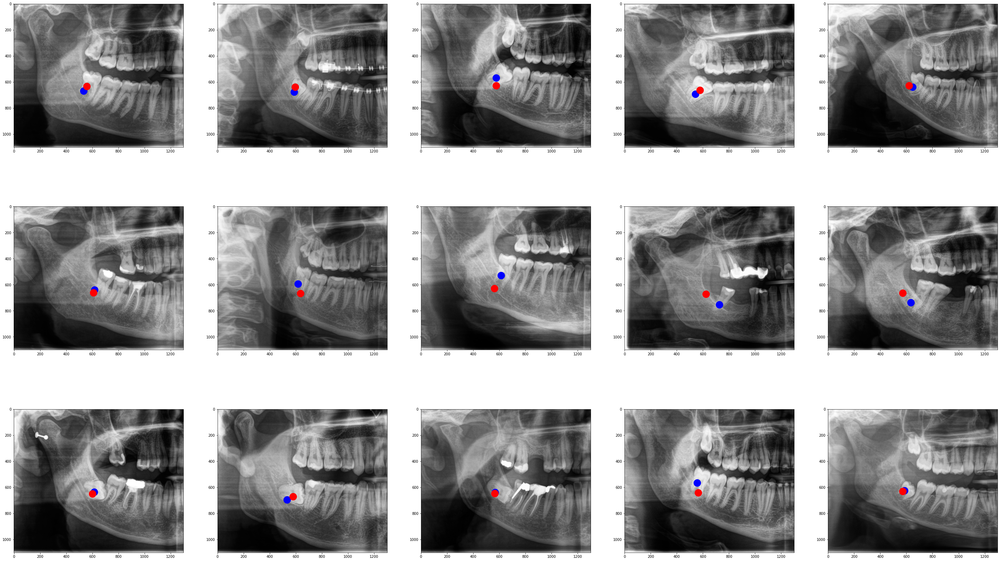

In [246]:
plt.rcParams['figure.figsize'] = [50,30]
fig = plt.figure()

for i in range(15):
    ax = fig.add_subplot(3, 5, i+1)
    ax.imshow(images_resnet[i])
    ax.plot(mse_gt[i][0], mse_gt[i][1], 'ob', markersize=20)
    ax.plot(mse_resnet[i][0], mse_resnet[i][1], 'or', markersize=20)

In [99]:
plt.rcParams['figure.figsize'] = [50,50]

In [100]:
#fig.savefig('../presentations/resnet.png')

# Point of reference - jaw and tooth size calculation

In [207]:
dir_images # 'data/annotated/patches/images_nmasks'

'data/annotated/patches/images_nmasks'

In [208]:
images_calc = []
masks_calc = []
image_ids_calc = []

In [209]:
for file in os.listdir(dir_images):
    filename = os.fsdecode(file)
    if filename.endswith('.gipl'):
        imagename = filename[:-4] + 'dcm'
        
        path_image = os.path.join(dir_images, imagename)
        path_mask = os.path.join(dir_images, filename)
            
        image = sitk.ReadImage(path_image)
        images_calc.append(image)
            
        mask = sitk.ReadImage(path_mask)
        masks_calc.append(mask)
            
        image_ids_calc.append(filename[:-5])      

In [210]:
image_arrays_calc = [sitk.GetArrayFromImage(image)[0, :, :] for image in images_calc]
masks_arrays_calc = [sitk.GetArrayFromImage(mask)[0, :, :] for mask in masks_calc]

In [211]:
csv_path_cv1_train = './data/annotated/annotations/with_molar/cv1/train_annotations.csv' ## combine these
csv_path_cv1_test = './data/annotated/annotations/with_molar/cv1/test_annotations.csv'  ## you get images with molars

cv1_train_df = pd.read_csv(csv_path_cv1_train)
cv1_test_df = pd.read_csv(csv_path_cv1_test)

full_annotations_with_molar = pd.concat([cv1_train_df, cv1_test_df], axis=0).reset_index(drop=True)

In [212]:
def preprocess_for_blob_analysis(img, mask):
    '''
    inputs in array format!
    '''
    img = (img - np.mean(img)) / np.std(img)
    img = img**mask
    img[img < 1.5] = 0
    img[img > 1.5] = 1
    
    return img

In [213]:
def find_biggest_blob(binary_img):
    binary_img = np.around(binary_img).astype('uint8')
    
    contours ,hierarchy = cv2.findContours(binary_img, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
    
    maxContour = 0
    for contour in contours:
        contourSize = cv2.contourArea(contour)
        if contourSize > maxContour:
            maxContour = contourSize
            maxContourData = contour
    # Create a mask from the largest contour
    output = np.zeros_like(binary_img)
    cv2.fillPoly(output,[maxContourData],1)
    
    return output

In [214]:
def calculate_tooth_dimensions(binary_img):
    
    segmentation_indexes = np.where(binary_img == 1)
    y_range = max(segmentation_indexes[0]) - min(segmentation_indexes[0])
    x_range = max(segmentation_indexes[1]) - min(segmentation_indexes[1])
    
    return x_range, y_range

In [217]:
dimensions = []

for i, id in enumerate(image_ids_calc):
    
    if id in list(full_annotations_with_molar['File_name']):
        
        try:
            considered_img_calc = image_arrays_calc[i]
            considered_mask_calc = masks_arrays_calc[i]
        
            considered_img_calc = preprocess_for_blob_analysis(considered_img_calc,
                                                          considered_mask_calc)
            considered_img_calc = find_biggest_blob(considered_img_calc)
            x_range, y_range = calculate_tooth_dimensions(considered_img_calc)
        
            dimensions.append([x_range, y_range])
        except:
            continue

In [219]:
len(dimensions)

178

In [221]:
xs = np.array([i[0] for i in dimensions])
ys = np.array([i[1] for i in dimensions])

In [228]:
print(np.mean(xs), ' pm ', np.std(xs))
print(np.mean(ys), ' pm ', np.std(ys))

147.3314606741573  pm  49.83768281334426
148.20224719101122  pm  57.21272738408311


(array([ 4., 13., 19., 12., 36., 27., 36., 20.,  9.,  2.]),
 array([  8. ,  35.7,  63.4,  91.1, 118.8, 146.5, 174.2, 201.9, 229.6,
        257.3, 285. ]),
 <BarContainer object of 10 artists>)

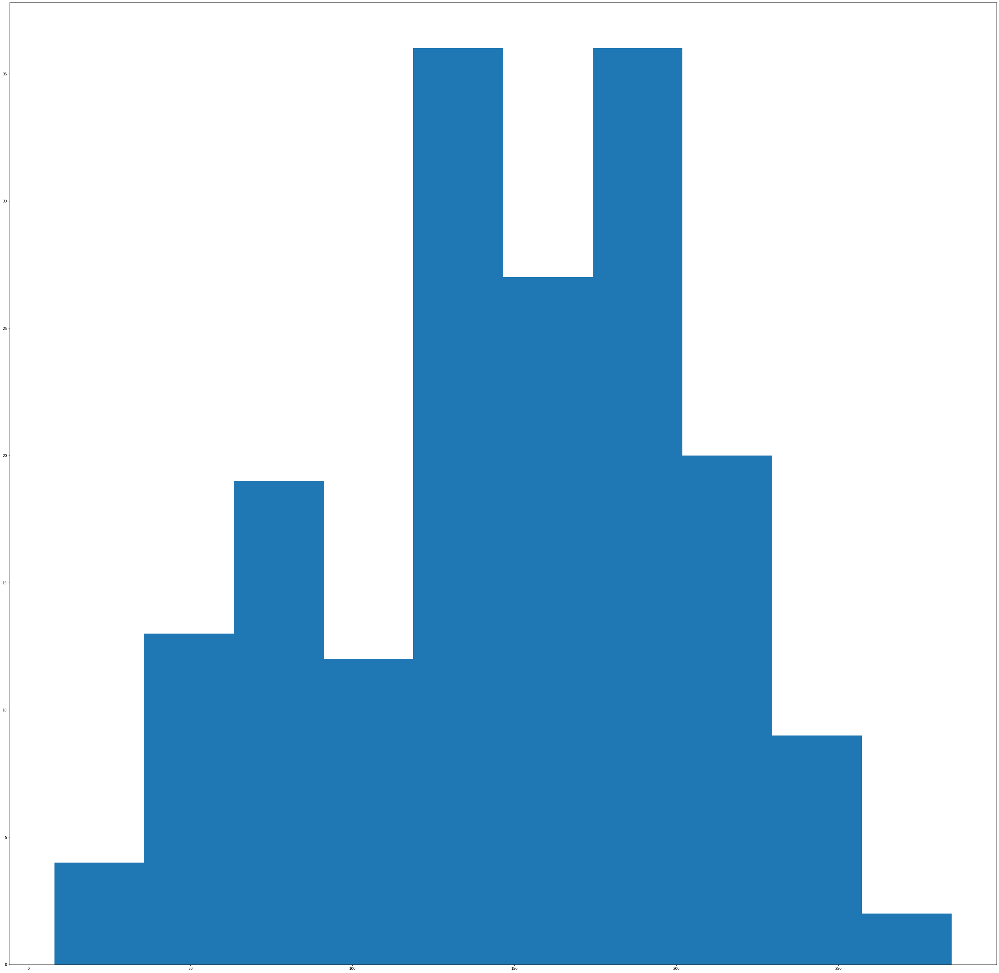

In [227]:
plt.hist(ys, bins=10)

In [229]:
## prepare a plot

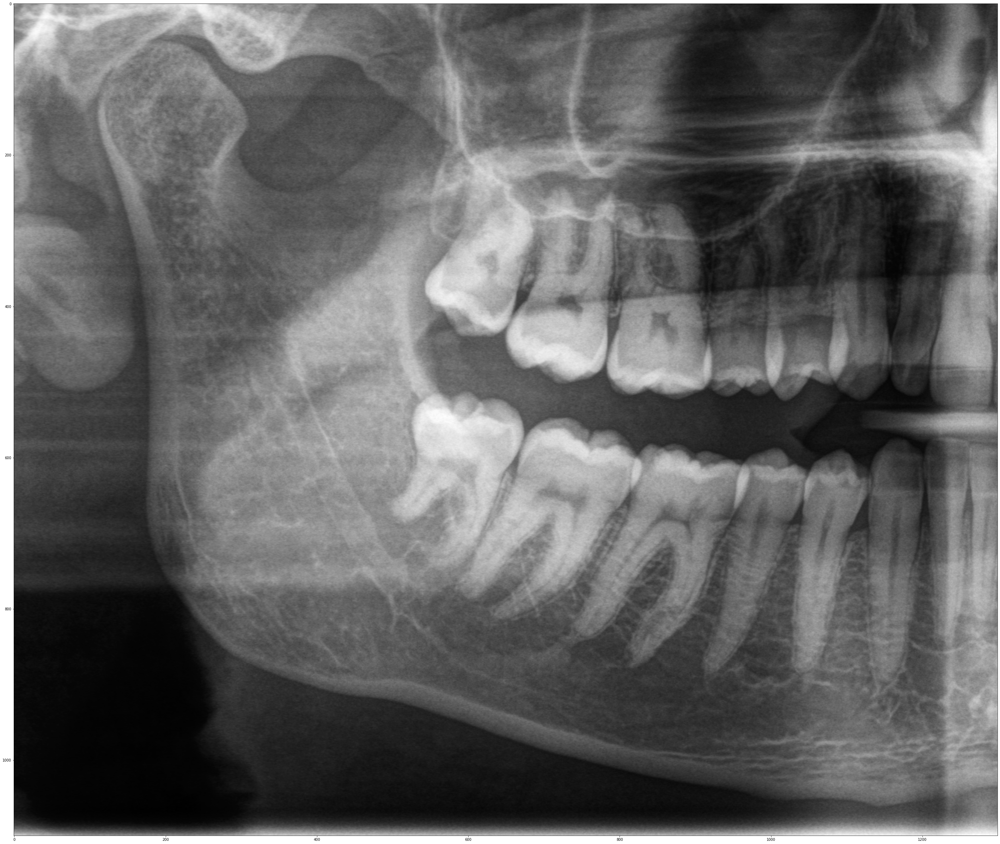

In [234]:
plt.imshow(image_arrays_calc[0])

In [238]:
prop_image = preprocess_for_blob_analysis(image_arrays_calc[0], masks_arrays_calc[0])
prop_image = find_biggest_blob(prop_image)
prop_cy, prop_cx = center_of_mass(prop_image)

In [246]:
prop_cx

586.8835928022645

In [247]:
prop_cy

603.694298422968

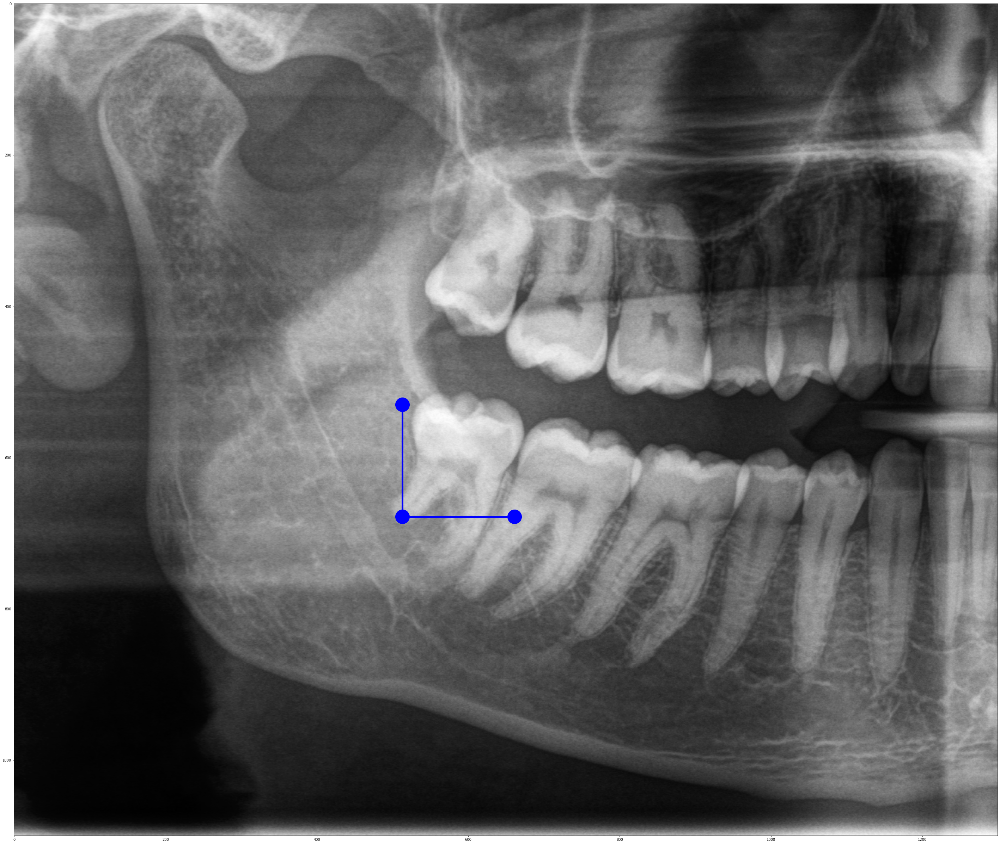

In [264]:
plt.imshow(image_arrays_calc[0])
#plt.plot(prop_cx, prop_cy, 'or')
plt.plot(prop_cx-74, prop_cy-74, 'ob', markersize=40)
plt.plot(prop_cx-74, prop_cy+74, 'ob', markersize=40)
plt.plot(prop_cx+74, prop_cy+74, 'ob', markersize=40)
plt.axvline(x=prop_cx-74 ,ymin=(1100-prop_cy+74)/image_arrays_calc[0].shape[0], ymax=(1100-prop_cy-74)/image_arrays_calc[0].shape[0] ,color='blue', lw=5)
plt.axhline(y=prop_cy+74 ,xmin=(prop_cx-74)/image_arrays_calc[0].shape[1], xmax=(prop_cx+74)/image_arrays_calc[0].shape[1] ,color='blue', lw=5)

#plt.savefig('../presentations/final/images/reference.png')